In [2]:
houseDatasetPath = r'F:\class\ut\2\data mining\CA1\Datasets\house.csv'
usersDatasetPath = r'F:\class\ut\2\data mining\CA1\Datasets\users.csv'
purchasesDatasetPath = r'F:\class\ut\2\data mining\CA1\Datasets\purchases.csv'

In [248]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer
from scipy import stats
from forex_python.converter import CurrencyRates
import requests
import shapefile as shp
import geopandas as gpd
from geopy.geocoders import Nominatim
import country_converter as coco

# Question 1:

### - preprocessing:

##### 1.

In [3]:
houseDataset = pd.read_csv(houseDatasetPath)

In [4]:
houseDataset.head(5)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


##### 2.

In [5]:
houseDataframe = pd.DataFrame(houseDataset);

In [6]:
total = houseDataframe.isnull().sum().sort_values(ascending = False)
percent = (houseDataframe.isnull().sum()/houseDataframe.isnull().count()).sort_values(ascending = False)
missing_data = pd.concat([total,percent], axis = 1, keys = ['Total', 'Percent'])
print(missing_data.to_string())

               Total   Percent
PoolQC          2909  0.996574
MiscFeature     2814  0.964029
Alley           2721  0.932169
Fence           2348  0.804385
FireplaceQu     1420  0.486468
LotFrontage      486  0.166495
GarageFinish     159  0.054471
GarageQual       159  0.054471
GarageCond       159  0.054471
GarageYrBlt      159  0.054471
GarageType       157  0.053786
BsmtExposure      82  0.028092
BsmtCond          82  0.028092
BsmtQual          81  0.027749
BsmtFinType2      80  0.027407
BsmtFinType1      79  0.027064
MasVnrType        24  0.008222
MasVnrArea        23  0.007879
MSZoning           4  0.001370
Functional         2  0.000685
Utilities          2  0.000685
BsmtHalfBath       2  0.000685
BsmtFullBath       2  0.000685
GarageArea         1  0.000343
BsmtFinSF1         1  0.000343
SaleType           1  0.000343
GarageCars         1  0.000343
BsmtUnfSF          1  0.000343
Electrical         1  0.000343
Exterior2nd        1  0.000343
Exterior1st        1  0.000343
KitchenQ

##### 3. It doesn't have any code. The answer is in the report file.

##### 4.

In [7]:
houseDataframe_noNULL = houseDataframe
houseDataframe_noNULL['PoolQC'] = houseDataframe_noNULL['PoolQC'].fillna('NoPool', inplace=False)
houseDataframe_noNULL['MiscFeature'] = houseDataframe_noNULL['MiscFeature'].fillna('None', inplace=False)
houseDataframe_noNULL['Alley'] = houseDataframe_noNULL['Alley'].fillna('NoAlleyAccess', inplace=False)
houseDataframe_noNULL['Fence'] = houseDataframe_noNULL['Fence'].fillna('NoFence', inplace=False)
houseDataframe_noNULL['FireplaceQu'] = houseDataframe_noNULL['FireplaceQu'].fillna('NoFireplace', inplace=False)
houseDataframe_noNULL['LotFrontage'] = houseDataframe_noNULL['LotFrontage'].fillna(np.mean(houseDataframe_noNULL['LotFrontage']), inplace=False)
houseDataframe_noNULL['GarageFinish'] = houseDataframe_noNULL['GarageFinish'].fillna('NoGarage', inplace=False)
houseDataframe_noNULL['GarageQual'] = houseDataframe_noNULL['GarageQual'].fillna('NoGarage', inplace=False)
houseDataframe_noNULL['GarageCond'] = houseDataframe_noNULL['GarageCond'].fillna('NoGarage', inplace=False)
houseDataframe_noNULL['GarageYrBlt'] = houseDataframe_noNULL['GarageYrBlt'].fillna(0, inplace=False)
houseDataframe_noNULL['GarageType'] = houseDataframe_noNULL['GarageType'].fillna('NoGarage', inplace=False)
houseDataframe_noNULL['BsmtExposure'] = houseDataframe_noNULL['BsmtExposure'].fillna('NoBasement', inplace=False)
houseDataframe_noNULL['BsmtCond'] = houseDataframe_noNULL['BsmtCond'].fillna('NoBasement', inplace=False)
houseDataframe_noNULL['BsmtQual'] = houseDataframe_noNULL['BsmtQual'].fillna('NoBasement', inplace=False)
houseDataframe_noNULL['BsmtFinType2'] = houseDataframe_noNULL['BsmtFinType2'].fillna('NoBasement', inplace=False)
houseDataframe_noNULL['BsmtFinType1'] = houseDataframe_noNULL['BsmtFinType1'].fillna('NoBasement', inplace=False)

In [8]:
to_show = houseDataframe_noNULL.isnull().sum().sort_values(ascending = False)
print(to_show.to_string())

MasVnrType       24
MasVnrArea       23
MSZoning          4
BsmtFullBath      2
BsmtHalfBath      2
Utilities         2
Functional        2
GarageArea        1
Electrical        1
TotalBsmtSF       1
BsmtUnfSF         1
BsmtFinSF2        1
KitchenQual       1
BsmtFinSF1        1
Exterior2nd       1
GarageCars        1
Exterior1st       1
SaleType          1
WoodDeckSF        0
PoolQC            0
SaleCondition     0
FullBath          0
HalfBath          0
BedroomAbvGr      0
KitchenAbvGr      0
YrSold            0
MoSold            0
MiscVal           0
MiscFeature       0
Fence             0
TotRmsAbvGrd      0
Fireplaces        0
PavedDrive        0
FireplaceQu       0
GarageType        0
GarageYrBlt       0
GarageFinish      0
PoolArea          0
ScreenPorch       0
3SsnPorch         0
GrLivArea         0
EnclosedPorch     0
OpenPorchSF       0
GarageQual        0
GarageCond        0
Id                0
HeatingQC         0
LowQualFinSF      0
LandSlope         0
OverallQual       0


In [9]:
houseDataframe_noNULL = houseDataframe_noNULL.dropna(axis=0, how="any", thresh=None, subset=None, inplace=False)

In [10]:
to_show = houseDataframe_noNULL.isnull().sum().sort_values(ascending = False)
print(to_show.to_string())

Id               0
CentralAir       0
GarageYrBlt      0
GarageType       0
FireplaceQu      0
Fireplaces       0
Functional       0
TotRmsAbvGrd     0
KitchenQual      0
KitchenAbvGr     0
BedroomAbvGr     0
HalfBath         0
FullBath         0
BsmtHalfBath     0
BsmtFullBath     0
GrLivArea        0
LowQualFinSF     0
2ndFlrSF         0
1stFlrSF         0
GarageFinish     0
GarageCars       0
GarageArea       0
PoolQC           0
SaleCondition    0
SaleType         0
YrSold           0
MoSold           0
MiscVal          0
MiscFeature      0
Fence            0
PoolArea         0
GarageQual       0
ScreenPorch      0
3SsnPorch        0
EnclosedPorch    0
OpenPorchSF      0
WoodDeckSF       0
PavedDrive       0
GarageCond       0
Electrical       0
HeatingQC        0
MSSubClass       0
Heating          0
OverallCond      0
OverallQual      0
HouseStyle       0
BldgType         0
Condition2       0
Condition1       0
Neighborhood     0
LandSlope        0
LotConfig        0
Utilities   

In [11]:
houseDataframe_noNULL

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2008,WD,Normal,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2914,2915,160,RM,21.0,1936,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,177000
2915,2916,160,RM,21.0,1894,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2006,WD,Abnorml,181000
2916,2917,20,RL,160.0,20000,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,9,2006,WD,Abnorml,176000
2917,2918,85,RL,62.0,10441,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,Shed,700,7,2006,WD,Normal,276000


##### 5.

###### -> using quartiles to deal with outliers:

###### ---> calculating quartiles of numeric columns:

In [14]:
def outlier_treatment(datacolumn):
 sorted(datacolumn)
 Q1,Q3 = np.percentile(datacolumn , [25,75])
 IQR = Q3 - Q1
 lower_range = Q1 - (1.5 * IQR)
 upper_range = Q3 + (1.5 * IQR)
 return lower_range,upper_range

In [20]:
lowerbound_MSSubClass,upperbound_MSSubClass = outlier_treatment(houseDataframe_noNULL.MSSubClass)
lowerbound_LotFrontage,upperbound_LotFrontage = outlier_treatment(houseDataframe_noNULL.LotFrontage)
lowerbound_LotArea,upperbound_LotArea = outlier_treatment(houseDataframe_noNULL.LotArea)
lowerbound_OverallQual,upperbound_OverallQual = outlier_treatment(houseDataframe_noNULL.OverallQual)
lowerbound_OverallCond,upperbound_OverallCond = outlier_treatment(houseDataframe_noNULL.OverallCond)
lowerbound_YearBuilt,upperbound_YearBuilt = outlier_treatment(houseDataframe_noNULL.YearBuilt)
lowerbound_YearRemodAdd,upperbound_YearRemodAdd = outlier_treatment(houseDataframe_noNULL.YearRemodAdd)
lowerbound_MasVnrArea,upperbound_MasVnrArea = outlier_treatment(houseDataframe_noNULL.MasVnrArea)
lowerbound_BsmtFinSF1,upperbound_BsmtFinSF1 = outlier_treatment(houseDataframe_noNULL.BsmtFinSF1)
lowerbound_BsmtFinSF2,upperbound_BsmtFinSF2 = outlier_treatment(houseDataframe_noNULL.BsmtFinSF2)
lowerbound_BsmtUnfSF,upperbound_BsmtUnfSF = outlier_treatment(houseDataframe_noNULL.BsmtUnfSF)
lowerbound_TotalBsmtSF,upperbound_TotalBsmtSF = outlier_treatment(houseDataframe_noNULL.TotalBsmtSF)
lowerbound_1stFlrSF,upperbound_1stFlrSF = outlier_treatment(houseDataframe_noNULL['1stFlrSF'])
lowerbound_2ndFlrSF,upperbound_2ndFlrSF = outlier_treatment(houseDataframe_noNULL['2ndFlrSF'])
lowerbound_LowQualFinSF,upperbound_LowQualFinSF = outlier_treatment(houseDataframe_noNULL.LowQualFinSF)
lowerbound_GrLivArea,upperbound_GrLivArea = outlier_treatment(houseDataframe_noNULL.GrLivArea)
lowerbound_BsmtFullBath,upperbound_BsmtFullBath = outlier_treatment(houseDataframe_noNULL.BsmtFullBath)
lowerbound_BsmtHalfBath,upperbound_BsmtHalfBath = outlier_treatment(houseDataframe_noNULL.BsmtHalfBath)
lowerbound_FullBath,upperbound_FullBath = outlier_treatment(houseDataframe_noNULL.FullBath)
lowerbound_HalfBath,upperbound_HalfBath = outlier_treatment(houseDataframe_noNULL.HalfBath)
lowerbound_BedroomAbvGr,upperbound_BedroomAbvGr = outlier_treatment(houseDataframe_noNULL.BedroomAbvGr)
lowerbound_KitchenAbvGr,upperbound_KitchenAbvGr = outlier_treatment(houseDataframe_noNULL.KitchenAbvGr)
lowerbound_TotRmsAbvGrd,upperbound_TotRmsAbvGrd = outlier_treatment(houseDataframe_noNULL.TotRmsAbvGrd)
lowerbound_Fireplaces,upperbound_Fireplaces = outlier_treatment(houseDataframe_noNULL.Fireplaces)
lowerbound_GarageYrBlt,upperbound_GarageYrBlt = outlier_treatment(houseDataframe_noNULL.GarageYrBlt)
lowerbound_GarageCars,upperbound_GarageCars = outlier_treatment(houseDataframe_noNULL.GarageCars)
lowerbound_GarageArea,upperbound_GarageArea = outlier_treatment(houseDataframe_noNULL.GarageArea)
lowerbound_WoodDeckSF,upperbound_WoodDeckSF = outlier_treatment(houseDataframe_noNULL.WoodDeckSF)
lowerbound_OpenPorchSF,upperbound_OpenPorchSF = outlier_treatment(houseDataframe_noNULL.OpenPorchSF)
lowerbound_EnclosedPorch,upperbound_EnclosedPorch = outlier_treatment(houseDataframe_noNULL.EnclosedPorch)
lowerbound_3SsnPorch,upperbound_3SsnPorch = outlier_treatment(houseDataframe_noNULL['3SsnPorch'])
lowerbound_ScreenPorch,upperbound_ScreenPorch = outlier_treatment(houseDataframe_noNULL.ScreenPorch)
lowerbound_PoolArea,upperbound_PoolArea = outlier_treatment(houseDataframe_noNULL.PoolArea)
lowerbound_MiscVal,upperbound_MiscVal = outlier_treatment(houseDataframe_noNULL.MiscVal)
lowerbound_MoSold,upperbound_MoSold = outlier_treatment(houseDataframe_noNULL.MoSold)
lowerbound_YrSold,upperbound_YrSold = outlier_treatment(houseDataframe_noNULL.YrSold)
lowerbound_SalePrice,upperbound_SalePrice = outlier_treatment(houseDataframe_noNULL.SalePrice)

In [21]:
houseDataframe_noNULL[(houseDataframe_noNULL.MSSubClass < lowerbound_MSSubClass) | (houseDataframe_noNULL.MSSubClass > upperbound_MSSubClass)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
9,10,190,RL,50.0,7420,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,1,2008,WD,Normal,118000
48,49,190,RM,33.0,4456,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,New,Partial,113000
56,57,160,FV,24.0,2645,Pave,Pave,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2009,WD,Abnorml,172500
75,76,180,RM,21.0,1596,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,GdWo,None,0,11,2009,WD,Normal,91000
87,88,160,FV,40.0,3951,Pave,Pave,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,New,Partial,164500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2910,2911,160,RM,21.0,1484,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2006,WD,Normal,410000
2912,2913,160,RM,21.0,1533,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Abnorml,178000
2913,2914,160,RM,21.0,1526,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,GdPrv,None,0,6,2006,WD,Normal,215200
2914,2915,160,RM,21.0,1936,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,177000


In [22]:
houseDataframe_noNULL[(houseDataframe_noNULL.LotFrontage < lowerbound_LotFrontage) | (houseDataframe_noNULL.LotFrontage > upperbound_LotFrontage)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
25,26,20,RL,110.0,14230,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2009,WD,Normal,256300
35,36,60,RL,108.0,13418,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,9,2006,WD,Normal,309000
36,37,20,RL,112.0,10859,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,WD,Normal,145000
41,42,20,RL,115.0,16905,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2007,WD,Normal,170000
52,53,90,RM,110.0,8472,Grvl,NoAlleyAccess,IR2,Bnk,AllPub,...,0,NoPool,NoFence,None,0,5,2010,WD,Normal,110000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2912,2913,160,RM,21.0,1533,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Abnorml,178000
2913,2914,160,RM,21.0,1526,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,GdPrv,None,0,6,2006,WD,Normal,215200
2914,2915,160,RM,21.0,1936,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,177000
2915,2916,160,RM,21.0,1894,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2006,WD,Abnorml,181000


In [23]:
houseDataframe_noNULL[(houseDataframe_noNULL.LotArea < lowerbound_LotArea) | (houseDataframe_noNULL.LotArea > upperbound_LotArea)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
53,54,20,RL,68.000000,50271,Pave,NoAlleyAccess,IR1,Low,AllPub,...,0,NoPool,NoFence,None,0,11,2006,WD,Normal,385000
66,67,20,RL,69.305795,19900,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2010,WD,Normal,180000
113,114,20,RL,69.305795,21000,Pave,NoAlleyAccess,Reg,Bnk,AllPub,...,0,NoPool,MnPrv,None,0,10,2007,COD,Abnorml,217000
120,121,80,RL,69.305795,21453,Pave,NoAlleyAccess,IR1,Low,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,180000
159,160,60,RL,134.000000,19378,Pave,NoAlleyAccess,IR1,HLS,AllPub,...,0,NoPool,NoFence,None,0,3,2006,New,Partial,320000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2850,2851,60,RL,69.305795,21533,Pave,NoAlleyAccess,IR2,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2006,WD,Normal,161750
2880,2881,50,RL,66.000000,21780,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,9,2006,WD,Normal,149900
2896,2897,20,RL,69.000000,23580,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,9,2006,WD,Normal,176000
2900,2901,20,RL,69.305795,50102,Pave,NoAlleyAccess,IR1,Low,AllPub,...,0,NoPool,NoFence,None,0,3,2006,WD,Alloca,158000


In [24]:
houseDataframe_noNULL[(houseDataframe_noNULL.OverallQual < lowerbound_OverallQual) | (houseDataframe_noNULL.OverallQual > upperbound_OverallQual)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
375,376,30,RL,69.305795,10020,Pave,NoAlleyAccess,IR1,Low,AllPub,...,0,NoPool,NoFence,None,0,3,2009,WD,Normal,61000
533,534,20,RL,50.000000,5000,Pave,NoAlleyAccess,Reg,Low,AllPub,...,0,NoPool,NoFence,None,0,1,2007,WD,Normal,39300


In [25]:
houseDataframe_noNULL[(houseDataframe_noNULL.OverallCond < lowerbound_OverallCond) | (houseDataframe_noNULL.OverallCond > upperbound_OverallCond)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1,2,20,RL,80.000000,9600,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2007,WD,Normal,181500
15,16,45,RM,51.000000,6120,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,GdPrv,None,0,7,2007,WD,Normal,132000
24,25,20,RL,69.305795,8246,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,5,2010,WD,Normal,154000
88,89,50,C (all),105.000000,8470,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,10,2009,ConLD,Abnorml,85000
91,92,20,RL,85.000000,8500,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,GdWo,None,0,12,2006,WD,Abnorml,98600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2867,2868,50,RL,72.000000,7822,Pave,NoAlleyAccess,Reg,Bnk,AllPub,...,0,NoPool,GdPrv,None,0,5,2006,WD,AdjLand,136000
2871,2872,30,RL,60.000000,8088,Pave,Grvl,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2006,ConLD,Normal,264561
2875,2876,70,RL,43.000000,7000,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,5,2006,WD,Normal,147400
2876,2877,70,RL,69.000000,4899,Pave,NoAlleyAccess,Reg,HLS,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,155000


In [26]:
houseDataframe_noNULL[(houseDataframe_noNULL.YearBuilt < lowerbound_YearBuilt) | (houseDataframe_noNULL.YearBuilt > upperbound_YearBuilt)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
304,305,75,RM,87.0,18386,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2008,WD,Normal,295000
630,631,70,RM,50.0,9000,Pave,Grvl,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,6,2006,WD,Abnorml,124000
747,748,70,RM,65.0,11700,Pave,Pave,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2009,WD,Normal,265979
991,992,70,RM,121.0,17671,Pave,Grvl,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,11,2009,WD,Normal,168000
1132,1133,70,RM,90.0,9900,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2007,WD,Normal,117500
1137,1138,50,RL,54.0,6342,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2010,WD,Normal,94000
1349,1350,70,RM,50.0,5250,Pave,Pave,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2008,WD,Normal,122000
1856,1857,70,RL,120.0,26400,Pave,NoAlleyAccess,Reg,Bnk,AllPub,...,0,NoPool,NoFence,None,0,6,2009,WD,Normal,174000
2451,2452,75,RM,75.0,13500,Pave,Grvl,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,2,2007,WD,Normal,154000


In [27]:
houseDataframe_noNULL[(houseDataframe_noNULL.YearRemodAdd < lowerbound_YearRemodAdd) | (houseDataframe_noNULL.YearRemodAdd > upperbound_YearRemodAdd)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice


In [28]:
houseDataframe_noNULL[(houseDataframe_noNULL.MasVnrArea < lowerbound_MasVnrArea) | (houseDataframe_noNULL.MasVnrArea > upperbound_MasVnrArea)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
25,26,20,RL,110.000000,14230,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2009,WD,Normal,256300
37,38,20,RL,74.000000,8532,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2009,WD,Normal,153000
45,46,120,RL,61.000000,7658,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2010,WD,Normal,319900
56,57,160,FV,24.000000,2645,Pave,Pave,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2009,WD,Abnorml,172500
58,59,60,RL,66.000000,13682,Pave,NoAlleyAccess,IR2,HLS,AllPub,...,0,NoPool,NoFence,None,0,10,2006,New,Partial,438780
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2741,2742,20,RL,69.305795,9610,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Normal,136500
2746,2747,20,RL,75.000000,10170,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,126500
2810,2811,20,RL,69.305795,9535,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,7,2006,WD,Normal,123000
2835,2836,60,RL,78.000000,9316,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,122000


In [29]:
houseDataframe_noNULL[(houseDataframe_noNULL.BsmtFinSF1 < lowerbound_BsmtFinSF1) | (houseDataframe_noNULL.BsmtFinSF1 > upperbound_BsmtFinSF1)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
70,71,20,RL,95.0,13651,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2007,WD,Normal,244000
178,179,20,RL,63.0,17423,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2009,New,Partial,501837
523,524,60,RL,130.0,40094,Pave,NoAlleyAccess,IR1,Bnk,AllPub,...,0,NoPool,NoFence,None,0,10,2007,New,Partial,184750
898,899,20,RL,100.0,12919,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,3,2010,New,Partial,611657
1182,1183,60,RL,160.0,15623,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,555,Ex,MnPrv,None,0,7,2007,WD,Abnorml,745000
1298,1299,60,RL,313.0,63887,Pave,NoAlleyAccess,IR3,Bnk,AllPub,...,480,Gd,NoFence,None,0,1,2008,New,Partial,160000
1629,1630,120,RL,28.0,7296,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,11,2009,WD,Normal,153000
1663,1664,20,RL,105.0,13693,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,3,2009,WD,Normal,79900
1671,1672,20,RL,110.0,15274,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,7,2009,WD,Normal,118500
1677,1678,20,RL,100.0,14836,Pave,NoAlleyAccess,IR1,HLS,AllPub,...,0,NoPool,NoFence,None,0,2,2009,WD,Abnorml,152000


In [30]:
houseDataframe_noNULL[(houseDataframe_noNULL.BsmtFinSF2 < lowerbound_BsmtFinSF2) | (houseDataframe_noNULL.BsmtFinSF2 > upperbound_BsmtFinSF2)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
7,8,60,RL,69.305795,10382,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,Shed,350,11,2009,WD,Normal,200000
24,25,20,RL,69.305795,8246,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,5,2010,WD,Normal,154000
26,27,20,RL,60.000000,7200,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2010,WD,Normal,134800
42,43,85,RL,69.305795,9180,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,12,2007,WD,Normal,144000
43,44,20,RL,69.305795,9200,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,7,2008,WD,Normal,130250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2828,2829,90,RL,73.000000,9069,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2006,WD,Normal,125000
2843,2844,80,RL,42.000000,10385,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2006,WD,Normal,148500
2858,2859,70,RL,67.000000,8777,Pave,NoAlleyAccess,Reg,Bnk,AllPub,...,0,NoPool,NoFence,Shed,420,10,2006,WD,Normal,168500
2901,2902,20,RL,69.305795,8098,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,127500


In [31]:
houseDataframe_noNULL[(houseDataframe_noNULL.BsmtUnfSF < lowerbound_BsmtUnfSF) | (houseDataframe_noNULL.BsmtUnfSF > upperbound_BsmtUnfSF)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
22,23,20,RL,75.000000,9742,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,9,2008,WD,Normal,230000
78,79,90,RL,72.000000,10778,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2010,WD,Normal,136500
137,138,90,RL,82.000000,11070,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2006,WD,Family,171000
169,170,20,RL,69.305795,16669,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,1,2006,WD,Normal,228000
224,225,20,RL,103.000000,13472,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,WD,Normal,386250
238,239,20,RL,93.000000,12030,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2007,New,Partial,318000
278,279,20,RL,107.000000,14450,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2007,New,Partial,415298
350,351,120,RL,68.000000,7820,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2007,New,Partial,318061
477,478,60,RL,105.000000,13693,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,3,2007,WD,Normal,380000
496,497,20,RL,69.305795,12692,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2007,WD,Normal,430000


In [32]:
houseDataframe_noNULL[(houseDataframe_noNULL.TotalBsmtSF < lowerbound_TotalBsmtSF) | (houseDataframe_noNULL.TotalBsmtSF > upperbound_TotalBsmtSF)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
17,18,90,RL,72.0,10791,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,Shed,500,10,2006,WD,Normal,90000
39,40,90,RL,65.0,6040,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2008,WD,AdjLand,82000
70,71,20,RL,95.0,13651,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2007,WD,Normal,244000
90,91,20,RL,60.0,7200,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2006,WD,Normal,109900
102,103,90,RL,64.0,7018,Pave,NoAlleyAccess,Reg,Bnk,AllPub,...,0,NoPool,NoFence,None,0,6,2009,WD,Alloca,118964
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2766,2767,90,RL,60.0,8544,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Normal,285000
2803,2804,20,RL,100.0,21370,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,Shed,600,6,2006,WD,Normal,230000
2804,2805,30,RL,55.0,8250,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,232000
2824,2825,20,RL,80.0,12048,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2006,WD,Normal,137450


In [34]:
houseDataframe_noNULL[(houseDataframe_noNULL['1stFlrSF'] < lowerbound_1stFlrSF) | (houseDataframe_noNULL['1stFlrSF'] > upperbound_1stFlrSF)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
66,67,20,RL,69.305795,19900,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2010,WD,Normal,180000
70,71,20,RL,95.000000,13651,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2007,WD,Normal,244000
113,114,20,RL,69.305795,21000,Pave,NoAlleyAccess,Reg,Bnk,AllPub,...,0,NoPool,MnPrv,None,0,10,2007,COD,Abnorml,217000
175,176,20,RL,84.000000,12615,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,6,2007,WD,Normal,243000
178,179,20,RL,63.000000,17423,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2009,New,Partial,501837
224,225,20,RL,103.000000,13472,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,WD,Normal,386250
440,441,20,RL,105.000000,15431,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2009,WD,Normal,555000
496,497,20,RL,69.305795,12692,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2007,WD,Normal,430000
523,524,60,RL,130.000000,40094,Pave,NoAlleyAccess,IR1,Bnk,AllPub,...,0,NoPool,NoFence,None,0,10,2007,New,Partial,184750
691,692,60,RL,104.000000,21535,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,1,2007,WD,Normal,755000


In [35]:
houseDataframe_noNULL[(houseDataframe_noNULL['2ndFlrSF'] < lowerbound_2ndFlrSF) | (houseDataframe_noNULL['2ndFlrSF'] > upperbound_2ndFlrSF)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
304,305,75,RM,87.0,18386,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2008,WD,Normal,295000
691,692,60,RL,104.0,21535,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,1,2007,WD,Normal,755000
1169,1170,60,RL,118.0,35760,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2006,WD,Normal,625000
1182,1183,60,RL,160.0,15623,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,555,Ex,MnPrv,None,0,7,2007,WD,Abnorml,745000
1593,1594,90,RH,60.0,7200,Pave,Pave,Reg,Lvl,AllPub,...,0,NoPool,NoFence,Shed,500,2,2010,WD,Normal,127000
2424,2425,70,RL,113.0,21281,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,11,2007,WD,Family,137000
2628,2629,60,RL,60.0,18062,Pave,NoAlleyAccess,IR1,HLS,AllPub,...,0,NoPool,NoFence,None,0,9,2006,New,Partial,412500
2822,2823,75,RL,60.0,19800,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Normal,240000


In [36]:
houseDataframe_noNULL[(houseDataframe_noNULL.LowQualFinSF < lowerbound_LowQualFinSF) | (houseDataframe_noNULL.LowQualFinSF > upperbound_LowQualFinSF)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
51,52,50,RM,52.000000,6240,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,Shed,400,9,2006,WD,Normal,114500
88,89,50,C (all),105.000000,8470,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,10,2009,ConLD,Abnorml,85000
125,126,190,RM,60.000000,6780,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,84500
170,171,50,RM,69.305795,12358,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2007,WD,Normal,128500
185,186,75,RM,90.000000,22950,Pave,NoAlleyAccess,IR2,Lvl,AllPub,...,0,NoPool,GdPrv,None,0,6,2006,WD,Normal,475000
187,188,50,RL,60.000000,10410,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,8,2009,WD,Normal,135000
197,198,75,RL,174.000000,25419,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,512,Ex,GdPrv,None,0,3,2006,WD,Abnorml,235000
198,199,75,RM,92.000000,5520,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,7,2009,WD,Abnorml,104000
263,264,50,RM,50.000000,5500,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2010,WD,Normal,130000
267,268,75,RL,60.000000,8400,Pave,NoAlleyAccess,Reg,Bnk,AllPub,...,0,NoPool,NoFence,None,0,7,2008,WD,Normal,179500


In [37]:
houseDataframe_noNULL[(houseDataframe_noNULL.GrLivArea < lowerbound_GrLivArea) | (houseDataframe_noNULL.GrLivArea > upperbound_GrLivArea)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
58,59,60,RL,66.000000,13682,Pave,NoAlleyAccess,IR2,HLS,AllPub,...,0,NoPool,NoFence,None,0,10,2006,New,Partial,438780
112,113,60,RL,77.000000,9965,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2007,New,Partial,383970
118,119,60,RL,90.000000,12376,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2010,WD,Normal,320000
185,186,75,RM,90.000000,22950,Pave,NoAlleyAccess,IR2,Lvl,AllPub,...,0,NoPool,GdPrv,None,0,6,2006,WD,Normal,475000
190,191,70,RL,70.000000,10570,Pave,NoAlleyAccess,Reg,Bnk,AllPub,...,0,NoPool,NoFence,None,0,12,2007,WD,Normal,315000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2681,2682,60,RL,83.000000,10019,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,386250
2682,2683,60,RL,114.000000,17242,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2006,WD,Normal,236000
2684,2685,60,RL,69.305795,12585,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,310000
2711,2712,60,RL,105.000000,11025,Pave,NoAlleyAccess,Reg,HLS,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,227000


In [38]:
houseDataframe_noNULL[(houseDataframe_noNULL.BsmtFullBath < lowerbound_BsmtFullBath) | (houseDataframe_noNULL.BsmtFullBath > upperbound_BsmtFullBath)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
738,739,90,RL,60.0,10800,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,3,2009,WD,Alloca,179000
1839,1840,90,RL,60.0,10800,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,3,2009,WD,Alloca,301000


In [39]:
houseDataframe_noNULL[(houseDataframe_noNULL.BsmtHalfBath < lowerbound_BsmtHalfBath) | (houseDataframe_noNULL.BsmtHalfBath > upperbound_BsmtHalfBath)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1,2,20,RL,80.0,9600,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2007,WD,Normal,181500
26,27,20,RL,60.0,7200,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2010,WD,Normal,134800
33,34,20,RL,70.0,10552,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2010,WD,Normal,165500
37,38,20,RL,74.0,8532,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2009,WD,Normal,153000
41,42,20,RL,115.0,16905,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2007,WD,Normal,170000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2869,2870,20,RL,60.0,16012,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,10,2006,WD,Abnorml,135000
2887,2888,50,RM,50.0,7000,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,5,2006,WD,Normal,250000
2895,2896,120,RM,44.0,3842,Pave,NoAlleyAccess,IR1,HLS,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Normal,169000
2896,2897,20,RL,69.0,23580,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,9,2006,WD,Normal,176000


In [40]:
houseDataframe_noNULL[(houseDataframe_noNULL.FullBath < lowerbound_FullBath) | (houseDataframe_noNULL.FullBath > upperbound_FullBath)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1619,1620,90,RL,70.000000,7700,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,Shed,600,2,2010,WD,Normal,370878
1861,1862,90,RL,69.305795,11855,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2009,WD,Normal,155000
1862,1863,90,RL,69.305795,7939,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2009,WD,Normal,156500
1863,1864,90,RL,69.305795,7976,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2009,WD,Normal,125000


In [41]:
houseDataframe_noNULL[(houseDataframe_noNULL.HalfBath < lowerbound_HalfBath) | (houseDataframe_noNULL.HalfBath > upperbound_HalfBath)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice


In [42]:
houseDataframe_noNULL[(houseDataframe_noNULL.BedroomAbvGr < lowerbound_BedroomAbvGr) | (houseDataframe_noNULL.BedroomAbvGr > upperbound_BedroomAbvGr)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
53,54,20,RL,68.000000,50271,Pave,NoAlleyAccess,IR1,Low,AllPub,...,0,NoPool,NoFence,None,0,11,2006,WD,Normal,385000
118,119,60,RL,90.000000,12376,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2010,WD,Normal,320000
137,138,90,RL,82.000000,11070,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2006,WD,Family,171000
144,145,90,RM,70.000000,9100,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,11,2006,ConLI,Abnorml,125000
189,190,120,RL,41.000000,4923,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2008,WD,Normal,286000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2796,2797,50,RM,90.000000,33120,Pave,NoAlleyAccess,IR3,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,381000
2812,2813,90,RL,69.305795,9662,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2006,WD,Normal,115000
2813,2814,90,RL,75.000000,8235,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2006,WD,Normal,191000
2822,2823,75,RL,60.000000,19800,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Normal,240000


In [43]:
houseDataframe_noNULL[(houseDataframe_noNULL.KitchenAbvGr < lowerbound_KitchenAbvGr) | (houseDataframe_noNULL.KitchenAbvGr > upperbound_KitchenAbvGr)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
8,9,50,RM,51.000000,6120,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.000000,7420,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,1,2008,WD,Normal,118000
17,18,90,RL,72.000000,10791,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,Shed,500,10,2006,WD,Normal,90000
39,40,90,RL,65.000000,6040,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2008,WD,AdjLand,82000
48,49,190,RM,33.000000,4456,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,New,Partial,113000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2859,2860,90,RL,38.000000,7840,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,AdjLand,228950
2892,2893,190,C (all),50.000000,9000,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Abnorml,120000
2897,2898,90,RL,65.000000,8385,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,168500
2905,2906,90,RM,78.000000,7020,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,11,2006,WD,Normal,173500


In [44]:
houseDataframe_noNULL[(houseDataframe_noNULL.TotRmsAbvGrd < lowerbound_TotRmsAbvGrd) | (houseDataframe_noNULL.TotRmsAbvGrd > upperbound_TotRmsAbvGrd)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
11,12,60,RL,85.000000,11924,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2006,New,Partial,345000
118,119,60,RL,90.000000,12376,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2010,WD,Normal,320000
185,186,75,RM,90.000000,22950,Pave,NoAlleyAccess,IR2,Lvl,AllPub,...,0,NoPool,GdPrv,None,0,6,2006,WD,Normal,475000
324,325,80,RL,96.000000,11275,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2010,WD,Normal,242000
523,524,60,RL,130.000000,40094,Pave,NoAlleyAccess,IR1,Bnk,AllPub,...,0,NoPool,NoFence,None,0,10,2007,New,Partial,184750
527,528,60,RL,67.000000,14948,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,11,2008,New,Partial,446261
566,567,60,RL,77.000000,11198,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2008,WD,Normal,325000
635,636,190,RH,60.000000,10896,Pave,Pave,Reg,Bnk,AllPub,...,0,NoPool,NoFence,None,0,3,2007,WD,Abnorml,200000
745,746,60,RL,69.305795,8963,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2008,WD,Normal,299800
769,770,60,RL,47.000000,53504,Pave,NoAlleyAccess,IR2,HLS,AllPub,...,0,NoPool,NoFence,None,0,6,2010,WD,Normal,538000


In [45]:
houseDataframe_noNULL[(houseDataframe_noNULL.Fireplaces < lowerbound_Fireplaces) | (houseDataframe_noNULL.Fireplaces > upperbound_Fireplaces)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
166,167,20,RL,69.305795,10708,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,GdWo,None,0,11,2009,COD,Normal,190000
309,310,20,RL,90.000000,12378,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,11,2006,WD,Normal,360000
605,606,60,RL,85.000000,13600,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2009,WD,Normal,205000
642,643,80,RL,75.000000,13860,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,7,2009,WD,Normal,345000
1298,1299,60,RL,313.000000,63887,Pave,NoAlleyAccess,IR3,Bnk,AllPub,...,480,Gd,NoFence,None,0,1,2008,New,Partial,160000
1660,1661,60,RL,110.000000,14257,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,WD,Normal,385000
2409,2410,20,RL,80.000000,9736,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2007,WD,Normal,184750
2567,2568,20,RL,69.305795,25485,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2007,WD,Normal,130000
2710,2711,80,RL,100.000000,14330,Pave,NoAlleyAccess,IR1,Low,AllPub,...,800,Gd,GdPrv,None,0,1,2006,WD,Normal,216500
2711,2712,60,RL,105.000000,11025,Pave,NoAlleyAccess,Reg,HLS,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,227000


In [46]:
houseDataframe_noNULL[(houseDataframe_noNULL.GarageYrBlt < lowerbound_GarageYrBlt) | (houseDataframe_noNULL.GarageYrBlt > upperbound_GarageYrBlt)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
39,40,90,RL,65.0,6040,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2008,WD,AdjLand,82000
48,49,190,RM,33.0,4456,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,New,Partial,113000
78,79,90,RL,72.0,10778,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2010,WD,Normal,136500
88,89,50,C (all),105.0,8470,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,10,2009,ConLD,Abnorml,85000
89,90,20,RL,60.0,8070,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2007,WD,Normal,123600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2893,2894,50,C (all),60.0,8520,Grvl,NoAlleyAccess,Reg,Bnk,AllPub,...,0,NoPool,NoFence,None,0,4,2006,WD,Normal,281000
2909,2910,180,RM,21.0,1470,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2006,WD,Normal,200000
2913,2914,160,RM,21.0,1526,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,GdPrv,None,0,6,2006,WD,Normal,215200
2914,2915,160,RM,21.0,1936,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,177000


In [47]:
houseDataframe_noNULL[(houseDataframe_noNULL.GarageCars < lowerbound_GarageCars) | (houseDataframe_noNULL.GarageCars > upperbound_GarageCars)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
420,421,90,RM,78.000000,7060,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,11,2008,WD,Alloca,206300
747,748,70,RM,65.000000,11700,Pave,Pave,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2009,WD,Normal,265979
1190,1191,190,RL,69.305795,32463,Pave,NoAlleyAccess,Reg,Low,AllPub,...,0,NoPool,NoFence,None,0,3,2007,WD,Normal,168000
1340,1341,20,RL,70.000000,8294,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,GdWo,None,0,6,2007,WD,Normal,123000
1350,1351,90,RL,91.000000,11643,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2009,WD,Normal,200000
1575,1576,60,RL,87.000000,12361,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2010,WD,Normal,143000
1828,1829,30,RM,50.000000,8635,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2009,WD,Normal,185900
1861,1862,90,RL,69.305795,11855,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2009,WD,Normal,155000
1862,1863,90,RL,69.305795,7939,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2009,WD,Normal,156500
1863,1864,90,RL,69.305795,7976,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2009,WD,Normal,125000


In [48]:
houseDataframe_noNULL[(houseDataframe_noNULL.GarageArea < lowerbound_GarageArea) | (houseDataframe_noNULL.GarageArea > upperbound_GarageArea)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
178,179,20,RL,63.000000,17423,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2009,New,Partial,501837
224,225,20,RL,103.000000,13472,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,WD,Normal,386250
270,271,60,FV,84.000000,10728,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2006,New,Partial,266000
317,318,60,FV,75.000000,9000,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2007,WD,Normal,270000
581,582,20,RL,98.000000,12704,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2009,New,Partial,253293
664,665,20,RL,49.000000,20896,Pave,NoAlleyAccess,IR2,Lvl,AllPub,...,0,NoPool,NoFence,None,0,1,2006,New,Partial,423000
718,719,60,RL,96.000000,10542,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2008,WD,Normal,341000
803,804,60,RL,107.000000,13891,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,1,2009,New,Partial,582933
825,826,20,RL,114.000000,14803,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2008,New,Partial,385000
1061,1062,30,C (all),120.000000,18000,Grvl,NoAlleyAccess,Reg,Low,AllPub,...,0,NoPool,NoFence,Shed,560,8,2008,ConLD,Normal,81000


In [49]:
houseDataframe_noNULL[(houseDataframe_noNULL.WoodDeckSF < lowerbound_WoodDeckSF) | (houseDataframe_noNULL.WoodDeckSF > upperbound_WoodDeckSF)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
53,54,20,RL,68.000000,50271,Pave,NoAlleyAccess,IR1,Low,AllPub,...,0,NoPool,NoFence,None,0,11,2006,WD,Normal,385000
64,65,60,RL,69.305795,9375,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,GdPrv,None,0,2,2009,WD,Normal,219500
166,167,20,RL,69.305795,10708,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,GdWo,None,0,11,2009,COD,Normal,190000
169,170,20,RL,69.305795,16669,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,1,2006,WD,Normal,228000
172,173,160,RL,44.000000,5306,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,WD,Normal,239000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2764,2765,60,RL,69.305795,18275,Pave,NoAlleyAccess,IR1,HLS,AllPub,...,0,NoPool,NoFence,None,0,9,2006,WD,Normal,155000
2822,2823,75,RL,60.000000,19800,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Normal,240000
2823,2824,80,RL,78.000000,11679,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,5,2006,WD,Normal,175500
2875,2876,70,RL,43.000000,7000,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,5,2006,WD,Normal,147400


In [50]:
houseDataframe_noNULL[(houseDataframe_noNULL.OpenPorchSF < lowerbound_OpenPorchSF) | (houseDataframe_noNULL.OpenPorchSF > upperbound_OpenPorchSF)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
7,8,60,RL,69.305795,10382,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,Shed,350,11,2009,WD,Normal,200000
14,15,20,RL,69.305795,10920,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,GdWo,None,0,5,2008,WD,Normal,157000
28,29,20,RL,47.000000,16321,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Normal,207500
81,82,120,RM,32.000000,4500,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,3,2006,WD,Normal,153500
87,88,160,FV,40.000000,3951,Pave,Pave,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,New,Partial,164500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2823,2824,80,RL,78.000000,11679,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,5,2006,WD,Normal,175500
2824,2825,20,RL,80.000000,12048,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2006,WD,Normal,137450
2827,2828,60,RL,88.000000,12128,Pave,NoAlleyAccess,IR1,Bnk,AllPub,...,0,NoPool,MnPrv,None,0,11,2006,WD,Abnorml,160000
2863,2864,60,RL,90.000000,11060,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2006,ConLD,Normal,149700


In [51]:
houseDataframe_noNULL[(houseDataframe_noNULL.EnclosedPorch < lowerbound_EnclosedPorch) | (houseDataframe_noNULL.EnclosedPorch > upperbound_EnclosedPorch)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
3,4,70,RL,60.000000,9550,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2006,WD,Abnorml,140000
7,8,60,RL,69.305795,10382,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.000000,6120,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2008,WD,Abnorml,129900
14,15,20,RL,69.305795,10920,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,GdWo,None,0,5,2008,WD,Normal,157000
21,22,45,RM,57.000000,7449,Pave,Grvl,Reg,Bnk,AllPub,...,0,NoPool,GdPrv,None,0,6,2007,WD,Normal,139400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2880,2881,50,RL,66.000000,21780,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,9,2006,WD,Normal,149900
2887,2888,50,RM,50.000000,7000,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,5,2006,WD,Normal,250000
2888,2889,30,RM,61.000000,8534,Pave,NoAlleyAccess,Reg,Low,AllPub,...,0,NoPool,GdWo,None,0,6,2006,WD,Normal,178000
2889,2890,30,RM,50.000000,7030,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,3,2006,WD,Normal,225000


In [54]:
houseDataframe_noNULL[(houseDataframe_noNULL['3SsnPorch'] < lowerbound_3SsnPorch) | (houseDataframe_noNULL['3SsnPorch'] > upperbound_3SsnPorch)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
5,6,50,RL,85.000000,14115,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,Shed,700,10,2009,WD,Normal,143000
55,56,20,RL,100.000000,10175,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2008,WD,Normal,180500
120,121,80,RL,69.305795,21453,Pave,NoAlleyAccess,IR1,Low,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,180000
129,130,20,RL,69.000000,8973,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnWw,None,0,7,2006,WD,Abnorml,150000
159,160,60,RL,134.000000,19378,Pave,NoAlleyAccess,IR1,HLS,AllPub,...,0,NoPool,NoFence,None,0,3,2006,New,Partial,320000
182,183,20,RL,60.000000,9060,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,6,2007,WD,Normal,120000
187,188,50,RL,60.000000,10410,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,None,0,8,2009,WD,Normal,135000
205,206,20,RL,99.000000,11851,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2009,WD,Normal,180500
237,238,60,RL,69.305795,9453,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2010,WD,Normal,194500
258,259,60,RL,80.000000,12435,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2008,WD,Normal,231500


In [55]:
houseDataframe_noNULL[(houseDataframe_noNULL.ScreenPorch < lowerbound_ScreenPorch) | (houseDataframe_noNULL.ScreenPorch > upperbound_ScreenPorch)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
12,13,20,RL,69.305795,12968,Pave,NoAlleyAccess,IR2,Lvl,AllPub,...,0,NoPool,NoFence,None,0,9,2008,WD,Normal,144000
46,47,50,RL,48.000000,12822,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2009,WD,Abnorml,239686
72,73,60,RL,74.000000,10141,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2009,WD,Normal,185000
80,81,60,RL,100.000000,13000,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2009,WD,Normal,193500
93,94,190,C (all),60.000000,7200,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,11,2007,WD,Normal,133900
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2883,2884,70,RL,70.000000,12320,Pave,NoAlleyAccess,IR1,HLS,AllPub,...,0,NoPool,GdWo,None,0,5,2006,WD,Normal,377426
2885,2886,60,RL,78.000000,15600,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2006,WD,Normal,118500
2894,2895,120,RM,41.000000,5748,Pave,NoAlleyAccess,IR1,HLS,AllPub,...,0,NoPool,NoFence,None,0,2,2006,New,Partial,302000
2895,2896,120,RM,44.000000,3842,Pave,NoAlleyAccess,IR1,HLS,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Normal,169000


In [56]:
houseDataframe_noNULL[(houseDataframe_noNULL.PoolArea < lowerbound_PoolArea) | (houseDataframe_noNULL.PoolArea > upperbound_PoolArea)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
197,198,75,RL,174.000000,25419,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,512,Ex,GdPrv,None,0,3,2006,WD,Abnorml,235000
810,811,20,RL,78.000000,10140,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,648,Fa,GdPrv,None,0,1,2006,WD,Normal,181000
1170,1171,80,RL,76.000000,9880,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,576,Gd,GdPrv,None,0,7,2008,WD,Normal,171000
1182,1183,60,RL,160.000000,15623,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,555,Ex,MnPrv,None,0,7,2007,WD,Abnorml,745000
1298,1299,60,RL,313.000000,63887,Pave,NoAlleyAccess,IR3,Bnk,AllPub,...,480,Gd,NoFence,None,0,1,2008,New,Partial,160000
1386,1387,60,RL,80.000000,16692,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,519,Fa,MnPrv,TenC,2000,7,2006,WD,Normal,250000
1423,1424,80,RL,69.305795,19690,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,738,Gd,GdPrv,None,0,8,2006,WD,Alloca,274970
1974,1975,20,RL,106.000000,12720,Pave,NoAlleyAccess,Reg,HLS,AllPub,...,144,Ex,NoFence,None,0,2,2008,WD,Normal,100000
2420,2421,20,RL,75.000000,9532,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,368,NoPool,GdPrv,None,0,2,2007,WD,Normal,119000
2503,2504,50,RL,104.000000,23920,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,444,NoPool,NoFence,None,0,4,2007,WD,Normal,179500


In [57]:
houseDataframe_noNULL[(houseDataframe_noNULL.MiscVal < lowerbound_MiscVal) | (houseDataframe_noNULL.MiscVal > upperbound_MiscVal)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
5,6,50,RL,85.000000,14115,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,MnPrv,Shed,700,10,2009,WD,Normal,143000
7,8,60,RL,69.305795,10382,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,Shed,350,11,2009,WD,Normal,200000
16,17,20,RL,69.305795,11241,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,Shed,700,3,2010,WD,Normal,149000
17,18,90,RL,72.000000,10791,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,Shed,500,10,2006,WD,Normal,90000
51,52,50,RM,52.000000,6240,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,MnPrv,Shed,400,9,2006,WD,Normal,114500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2790,2791,20,RM,65.000000,9750,Pave,Grvl,Reg,Lvl,AllPub,...,0,NoPool,NoFence,Gar2,4500,7,2006,WD,Normal,169000
2803,2804,20,RL,100.000000,21370,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,Shed,600,6,2006,WD,Normal,230000
2808,2809,80,RL,80.000000,10366,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,GdPrv,Shed,500,7,2006,WD,Normal,137000
2858,2859,70,RL,67.000000,8777,Pave,NoAlleyAccess,Reg,Bnk,AllPub,...,0,NoPool,NoFence,Shed,420,10,2006,WD,Normal,168500


In [58]:
houseDataframe_noNULL[(houseDataframe_noNULL.MoSold < lowerbound_MoSold) | (houseDataframe_noNULL.MoSold > upperbound_MoSold)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice


In [59]:
houseDataframe_noNULL[(houseDataframe_noNULL.YrSold < lowerbound_YrSold) | (houseDataframe_noNULL.YrSold > upperbound_YrSold)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice


In [60]:
houseDataframe_noNULL[(houseDataframe_noNULL.SalePrice < lowerbound_SalePrice) | (houseDataframe_noNULL.SalePrice > upperbound_SalePrice)]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
11,12,60,RL,85.0,11924,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2006,New,Partial,345000
53,54,20,RL,68.0,50271,Pave,NoAlleyAccess,IR1,Low,AllPub,...,0,NoPool,NoFence,None,0,11,2006,WD,Normal,385000
58,59,60,RL,66.0,13682,Pave,NoAlleyAccess,IR2,HLS,AllPub,...,0,NoPool,NoFence,None,0,10,2006,New,Partial,438780
112,113,60,RL,77.0,9965,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2007,New,Partial,383970
151,152,20,RL,107.0,13891,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,1,2008,New,Partial,372402
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2796,2797,50,RM,90.0,33120,Pave,NoAlleyAccess,IR3,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,381000
2851,2852,60,RL,90.0,11250,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2006,WD,Normal,745000
2883,2884,70,RL,70.0,12320,Pave,NoAlleyAccess,IR1,HLS,AllPub,...,0,NoPool,GdWo,None,0,5,2006,WD,Normal,377426
2910,2911,160,RM,21.0,1484,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2006,WD,Normal,410000


###### ---> removing the rows containing any outlier values:

In [62]:
houseDataframe_noNULL_noOutlier = houseDataframe_noNULL.copy(deep=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.MSSubClass > upperbound_MSSubClass) | (houseDataframe_noNULL_noOutlier.MSSubClass < lowerbound_MSSubClass) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.LotFrontage > upperbound_LotFrontage) | (houseDataframe_noNULL_noOutlier.LotFrontage < lowerbound_LotFrontage) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.LotArea > upperbound_LotArea) | (houseDataframe_noNULL_noOutlier.LotArea < lowerbound_LotArea) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.OverallQual > upperbound_OverallQual) | (houseDataframe_noNULL_noOutlier.OverallQual < lowerbound_OverallQual) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.OverallCond > upperbound_OverallCond) | (houseDataframe_noNULL_noOutlier.OverallCond < lowerbound_OverallCond) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.YearBuilt > upperbound_YearBuilt) | (houseDataframe_noNULL_noOutlier.YearBuilt < lowerbound_YearBuilt) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.YearRemodAdd > upperbound_YearRemodAdd) | (houseDataframe_noNULL_noOutlier.YearRemodAdd < lowerbound_YearRemodAdd) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.MasVnrArea > upperbound_MasVnrArea) | (houseDataframe_noNULL_noOutlier.MasVnrArea < lowerbound_MasVnrArea) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.BsmtFinSF1 > upperbound_BsmtFinSF1) | (houseDataframe_noNULL_noOutlier.BsmtFinSF1 < lowerbound_BsmtFinSF1) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.BsmtFinSF2 > upperbound_BsmtFinSF2) | (houseDataframe_noNULL_noOutlier.BsmtFinSF2 < lowerbound_BsmtFinSF2) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.BsmtUnfSF > upperbound_BsmtUnfSF) | (houseDataframe_noNULL_noOutlier.BsmtUnfSF < lowerbound_BsmtUnfSF) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.TotalBsmtSF > upperbound_TotalBsmtSF) | (houseDataframe_noNULL_noOutlier.TotalBsmtSF < lowerbound_TotalBsmtSF) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier['1stFlrSF'] > upperbound_1stFlrSF) | (houseDataframe_noNULL_noOutlier['1stFlrSF'] < lowerbound_1stFlrSF) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier['2ndFlrSF'] > upperbound_2ndFlrSF) | (houseDataframe_noNULL_noOutlier['2ndFlrSF'] < lowerbound_2ndFlrSF) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.LowQualFinSF > upperbound_LowQualFinSF) | (houseDataframe_noNULL_noOutlier.LowQualFinSF < lowerbound_LowQualFinSF) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.GrLivArea > upperbound_GrLivArea) | (houseDataframe_noNULL_noOutlier.GrLivArea < lowerbound_GrLivArea) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.BsmtFullBath > upperbound_BsmtFullBath) | (houseDataframe_noNULL_noOutlier.BsmtFullBath < lowerbound_BsmtFullBath) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.BsmtHalfBath > upperbound_BsmtHalfBath) | (houseDataframe_noNULL_noOutlier.BsmtHalfBath < lowerbound_BsmtHalfBath) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.FullBath > upperbound_FullBath) | (houseDataframe_noNULL_noOutlier.FullBath < lowerbound_FullBath) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.HalfBath > upperbound_HalfBath) | (houseDataframe_noNULL_noOutlier.HalfBath < lowerbound_HalfBath) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.BedroomAbvGr > upperbound_BedroomAbvGr) | (houseDataframe_noNULL_noOutlier.BedroomAbvGr < lowerbound_BedroomAbvGr) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.KitchenAbvGr > upperbound_KitchenAbvGr) | (houseDataframe_noNULL_noOutlier.KitchenAbvGr < lowerbound_KitchenAbvGr) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.TotRmsAbvGrd > upperbound_TotRmsAbvGrd) | (houseDataframe_noNULL_noOutlier.TotRmsAbvGrd < lowerbound_TotRmsAbvGrd) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.Fireplaces > upperbound_Fireplaces) | (houseDataframe_noNULL_noOutlier.Fireplaces < lowerbound_Fireplaces) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.GarageYrBlt > upperbound_GarageYrBlt) | (houseDataframe_noNULL_noOutlier.GarageYrBlt < lowerbound_GarageYrBlt) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.GarageCars > upperbound_GarageCars) | (houseDataframe_noNULL_noOutlier.GarageCars < lowerbound_GarageCars) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.GarageArea > upperbound_GarageArea) | (houseDataframe_noNULL_noOutlier.GarageArea < lowerbound_GarageArea) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.WoodDeckSF > upperbound_WoodDeckSF) | (houseDataframe_noNULL_noOutlier.WoodDeckSF < lowerbound_WoodDeckSF) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.OpenPorchSF > upperbound_OpenPorchSF) | (houseDataframe_noNULL_noOutlier.OpenPorchSF < lowerbound_OpenPorchSF) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.EnclosedPorch > upperbound_EnclosedPorch) | (houseDataframe_noNULL_noOutlier.EnclosedPorch < lowerbound_EnclosedPorch) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier['3SsnPorch'] > upperbound_3SsnPorch) | (houseDataframe_noNULL_noOutlier['3SsnPorch'] < lowerbound_3SsnPorch) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.ScreenPorch > upperbound_ScreenPorch) | (houseDataframe_noNULL_noOutlier.ScreenPorch < lowerbound_ScreenPorch) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.PoolArea > upperbound_PoolArea) | (houseDataframe_noNULL_noOutlier.PoolArea < lowerbound_PoolArea) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.MiscVal > upperbound_MiscVal) | (houseDataframe_noNULL_noOutlier.MiscVal < lowerbound_MiscVal) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.MoSold > upperbound_MoSold) | (houseDataframe_noNULL_noOutlier.MoSold < lowerbound_MoSold) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.YrSold > upperbound_YrSold) | (houseDataframe_noNULL_noOutlier.YrSold < lowerbound_YrSold) ].index , inplace=True)
houseDataframe_noNULL_noOutlier.drop(houseDataframe_noNULL_noOutlier[ (houseDataframe_noNULL_noOutlier.SalePrice > upperbound_SalePrice) | (houseDataframe_noNULL_noOutlier.SalePrice < lowerbound_SalePrice) ].index , inplace=True)
houseDataframe_noNULL_noOutlier

C:\Users\Marzieh\anaconda3\lib\site-packages\pandas\core\frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(
C:\Users\Marzieh\anaconda3\lib\site-packages\pandas\core\frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(
C:\Users\Marzieh\anaconda3\lib\site-packages\pandas\core\frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(
C:\Users\Marzieh\anaco

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2008,WD,Normal,208500
2,3,60,RL,68.0,11250,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,9,2008,WD,Normal,223500
4,5,60,RL,84.0,14260,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2008,WD,Normal,250000
6,7,20,RL,75.0,10084,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2007,WD,Normal,307000
10,11,20,RL,70.0,11200,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2008,WD,Normal,129500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2890,2891,50,RM,75.0,9060,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2006,WD,Normal,149000
2898,2899,20,RL,70.0,9116,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2006,WD,Normal,97000
2902,2903,20,RL,95.0,13618,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,11,2006,New,Partial,257000
2907,2908,20,RL,58.0,10172,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,128950


###### -> using normalization to deal with outliers:

In [12]:
houseDataframe_noNULL_noOutlier_zscore = houseDataframe_noNULL.copy(deep=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['MSSubClass']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['MSSubClass']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['LotFrontage']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['LotFrontage']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['LotArea']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['LotArea']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['OverallQual']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['OverallQual']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['OverallCond']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['OverallCond']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['YearBuilt']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['YearBuilt']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['YearRemodAdd']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['YearRemodAdd']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['MasVnrArea']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['MasVnrArea']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BsmtFinSF1']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BsmtFinSF1']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BsmtFinSF2']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BsmtFinSF2']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BsmtUnfSF']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BsmtUnfSF']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['TotalBsmtSF']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['TotalBsmtSF']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['1stFlrSF']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['1stFlrSF']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['2ndFlrSF']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['2ndFlrSF']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['LowQualFinSF']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['LowQualFinSF']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['GrLivArea']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['GrLivArea']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BsmtFullBath']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BsmtFullBath']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BsmtHalfBath']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BsmtHalfBath']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['FullBath']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['FullBath']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['HalfBath']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['HalfBath']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BedroomAbvGr']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['BedroomAbvGr']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['KitchenAbvGr']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['KitchenAbvGr']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['TotRmsAbvGrd']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['TotRmsAbvGrd']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['Fireplaces']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['Fireplaces']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['GarageYrBlt']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['GarageYrBlt']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['GarageCars']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['GarageCars']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['GarageArea']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['GarageArea']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['WoodDeckSF']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['WoodDeckSF']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['OpenPorchSF']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['OpenPorchSF']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['EnclosedPorch']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['EnclosedPorch']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['3SsnPorch']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['3SsnPorch']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['ScreenPorch']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['ScreenPorch']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['PoolArea']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['PoolArea']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['MiscVal']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['MiscVal']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['MoSold']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['MoSold']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['YrSold']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['YrSold']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore.drop(houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['SalePrice']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['SalePrice']) < -3) ].index , inplace=True)
houseDataframe_noNULL_noOutlier_zscore

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2008,WD,Normal,208500
2,3,60,RL,68.0,11250,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,9,2008,WD,Normal,223500
4,5,60,RL,84.0,14260,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2008,WD,Normal,250000
6,7,20,RL,75.0,10084,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,8,2007,WD,Normal,307000
10,11,20,RL,70.0,11200,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2008,WD,Normal,129500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2906,2907,160,RM,41.0,2665,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2006,WD,Normal,139000
2907,2908,20,RL,58.0,10172,Pave,NoAlleyAccess,IR1,Lvl,AllPub,...,0,NoPool,NoFence,None,0,10,2006,WD,Normal,128950
2912,2913,160,RM,21.0,1533,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,12,2006,WD,Abnorml,178000
2915,2916,160,RM,21.0,1894,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2006,WD,Abnorml,181000


In [13]:
houseDataframe_noNULL_noOutlier_zscore[ (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['MSSubClass']) > 3) | (stats.zscore(houseDataframe_noNULL_noOutlier_zscore['MSSubClass']) < -3) ]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
75,76,180,RM,21.000000,1596,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,GdWo,None,0,11,2009,WD,Normal,91000
472,473,180,RM,35.000000,3675,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2008,WD,Normal,148000
489,490,180,RM,21.000000,1526,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2009,WD,Normal,86000
1039,1040,180,RM,21.000000,1477,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2009,WD,Normal,80000
1297,1298,180,RM,35.000000,3675,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2006,New,Partial,140000
1452,1453,180,RM,35.000000,3675,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2006,WD,Normal,145000
1890,1891,180,RM,35.000000,3675,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,4,2009,WD,Normal,142000
2243,2244,180,RM,21.000000,1974,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,6,2008,WD,Normal,178000
2550,2551,180,RM,35.000000,3675,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,5,2007,WD,Normal,144500
2602,2603,180,RM,69.305795,1533,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2007,WD,Normal,159895


##### 6.

In [14]:
print('Id1', 'SP1', ' LA1', ' Id2', 'SP2', ' LA2')
for index1, row1 in houseDataframe_noNULL_noOutlier_zscore.iterrows():
    for index2, row2 in houseDataframe_noNULL_noOutlier_zscore.iterrows():
            if row1['SalePrice'] > row2['SalePrice'] and row1['LotArea'] < row2['LotArea']:
                print(row1['Id'], row1['SalePrice'], row1['LotArea'], row2['Id'], row2['SalePrice'], row2['LotArea'])

Id1 SP1  LA1  Id2 SP2  LA2
1 208500 8450 11 129500 11200
1 208500 8450 13 144000 12968
1 208500 8450 15 157000 10920
1 208500 8450 17 149000 11241
1 208500 8450 19 159000 13695
1 208500 8450 31 40000 8500
1 208500 8450 32 149350 8544
1 208500 8450 33 179900 11049
1 208500 8450 37 145000 10859
1 208500 8450 41 160000 8658
1 208500 8450 43 144000 9180
1 208500 8450 44 130250 9200
1 208500 8450 58 196500 11645
1 208500 8450 61 158000 13072
1 208500 8450 64 140000 10300
1 208500 8450 74 144900 10200
1 208500 8450 77 135750 8475
1 208500 8450 78 127000 8635
1 208500 8450 80 110000 10440
1 208500 8450 84 126500 8892
1 208500 8450 85 168500 8530
1 208500 8450 87 174000 11911
1 208500 8450 92 98600 8500
1 208500 8450 93 163500 13360
1 208500 8450 95 204750 9337
1 208500 8450 96 185000 9765
1 208500 8450 98 94750 10921
1 208500 8450 99 83000 10625
1 208500 8450 101 205000 10603
1 208500 8450 102 178000 9206
1 208500 8450 104 198900 10402
1 208500 8450 107 100000 10800
1 208500 8450 110 190000 1

In [15]:
first_comparison = houseDataframe_noNULL_noOutlier_zscore[(houseDataframe_noNULL_noOutlier_zscore['Id']==1) | (houseDataframe_noNULL_noOutlier_zscore['Id']==11)]
first_comparison

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2008,WD,Normal,208500
10,11,20,RL,70.0,11200,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,2,2008,WD,Normal,129500


In [16]:
first_comparison_cols = first_comparison[['Id', 'OverallQual', 'YearBuilt', 'MasVnrType', 'ExterQual', 'BsmtQual', '1stFlrSF', '2ndFlrSF', 'KitchenQual', 'GarageArea', 'LotArea', 'SalePrice']].copy()
first_comparison_cols

,Id,OverallQual,YearBuilt,MasVnrType,ExterQual,BsmtQual,1stFlrSF,2ndFlrSF,KitchenQual,GarageArea,LotArea,SalePrice
0,1,7,2003,BrkFace,Gd,Gd,856,854,Gd,548.0,8450,208500
10,11,5,1965,None,TA,TA,1040,0,TA,384.0,11200,129500


In [17]:
second_comparison = houseDataframe_noNULL_noOutlier_zscore[(houseDataframe_noNULL_noOutlier_zscore['Id']==1403) | (houseDataframe_noNULL_noOutlier_zscore['Id']==1425)]
second_comparison

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1402,1403,20,RL,64.000000,6762,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,NoFence,None,0,7,2006,New,Partial,193879
1424,1425,20,RL,69.305795,9503,Pave,NoAlleyAccess,Reg,Lvl,AllPub,...,0,NoPool,GdWo,None,0,6,2007,WD,Normal,144000


In [18]:
second_comparison_cols = second_comparison[['Id', 'OverallQual', 'YearBuilt', 'ExterQual', 'BsmtQual', 'BsmtCond', 'TotalBsmtSF', 'HeatingQC', 'KitchenQual', 'FireplaceQu', 'GarageCars', 'GarageArea', 'LotArea', 'SalePrice']].copy()
second_comparison_cols

,Id,OverallQual,YearBuilt,ExterQual,BsmtQual,BsmtCond,TotalBsmtSF,HeatingQC,KitchenQual,FireplaceQu,GarageCars,GarageArea,LotArea,SalePrice
1402,1403,7,2006,Gd,Gd,Gd,1286.0,Ex,Gd,Gd,2.0,662.0,6762,193879
1424,1425,5,1958,TA,TA,TA,1024.0,TA,TA,TA,1.0,484.0,9503,144000


### - visualizing:

##### 1.

In [35]:
groups = houseDataframe_noNULL_noOutlier_zscore.groupby('Neighborhood')

In [38]:
average_SP = groups['SalePrice'].aggregate(['mean'])
average_SP

,mean
Neighborhood,
Blmngtn,174350.760000
Blueste,171495.500000
BrDale,135385.185185
BrkSide,152075.000000
ClearCr,177487.076923
CollgCr,188213.114894
Crawfor,182520.260000
Edwards,155744.739496
Gilbert,179539.246377


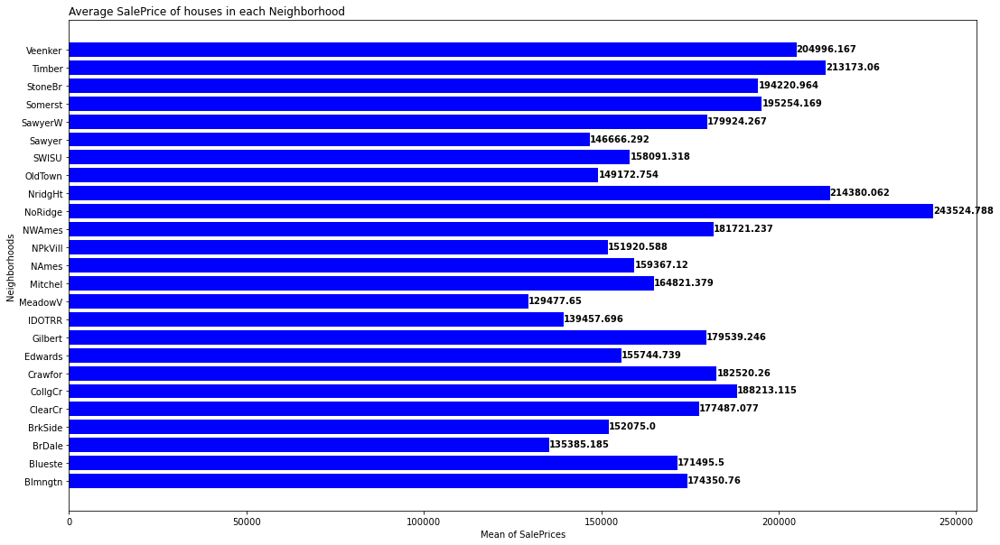

In [83]:
y = houseDataframe_noNULL_noOutlier_zscore.groupby('Neighborhood').mean().reset_index()
fig, ax = plt.subplots(figsize =(18,10))
ax.barh(range(len(y)), y['SalePrice'], color="blue")
plt.yticks(range(len(y)), y['Neighborhood'])
plt.xlabel('Mean of SalePrices')
plt.ylabel('Neighborhoods')
ax.set_title('Average SalePrice of houses in each Neighborhood', loc ='left', )
for i in ax.patches:
    plt.text(i.get_width()+0.2, i.get_y()+0.3,
             str(round((i.get_width()), 3)),
             fontsize = 10, fontweight = 'bold',
             color ='black')
plt.show()

In [96]:
y.sort_values('SalePrice', axis=0, ascending=True, inplace=True, kind='quicksort', na_position='last', ignore_index=False, key=None)
y

,Neighborhood,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
10,MeadowV,1586.850000,161.000000,35.561159,2235.450000,4.350000,5.350000,1973.100000,1976.350000,4.000000,...,73.500000,35.250000,3.200000,0.000000,0.000000,0.0,0.000000,5.850000,2007.850000,129477.650000
2,BrDale,1378.740741,160.000000,21.555556,1858.481481,5.703704,5.407407,1971.814815,1973.111111,371.888889,...,76.777778,6.074074,0.000000,0.000000,0.000000,0.0,0.000000,6.481481,2007.740741,135385.185185
9,IDOTRR,1570.869565,46.086957,59.904600,7927.413043,4.913043,6.065217,1930.217391,1964.413043,15.717391,...,16.760870,34.195652,62.913043,0.000000,4.913043,0.0,1.173913,5.782609,2007.565217,139457.695652
19,Sawyer,1405.921348,33.426966,72.153964,10021.617978,5.033708,5.898876,1963.977528,1976.876404,40.370787,...,83.539326,18.797753,8.797753,0.000000,7.202247,0.0,27.528090,5.842697,2007.730337,146666.292135
17,OldTown,1533.460317,45.436508,59.289913,7456.412698,5.000000,6.420635,1927.150794,1973.611111,15.492063,...,39.420635,27.412698,60.317460,0.000000,4.015873,0.0,16.269841,6.341270,2007.706349,149172.753968
13,NPkVill,1494.764706,143.529412,31.035976,2719.823529,6.235294,5.705882,1976.470588,1976.470588,0.000000,...,42.647059,29.705882,0.000000,0.000000,9.705882,0.0,0.000000,6.058824,2008.411765,151920.588235
3,BrkSide,1511.589041,47.123288,56.069287,6693.780822,5.315068,6.369863,1931.821918,1969.520548,11.671233,...,44.520548,17.739726,41.000000,0.000000,12.397260,0.0,8.493151,5.917808,2007.767123,152075.000000
7,Edwards,1506.445378,51.806723,64.400584,9337.647059,5.067227,5.445378,1958.831933,1974.378151,31.605042,...,63.705882,20.176471,20.974790,0.000000,14.252101,0.0,20.756303,5.689076,2007.932773,155744.739496
18,SWISU,1712.409091,45.909091,59.877536,7148.545455,5.500000,5.318182,1934.045455,1962.863636,21.136364,...,84.363636,32.590909,39.090909,0.000000,12.818182,0.0,0.000000,5.590909,2008.136364,158091.318182
12,NAmes,1436.730337,33.632959,71.618846,9363.277154,5.280899,5.823970,1959.913858,1968.677903,76.254682,...,56.662921,24.917603,15.355805,0.000000,12.861423,0.0,27.902622,6.314607,2007.808989,159367.119850


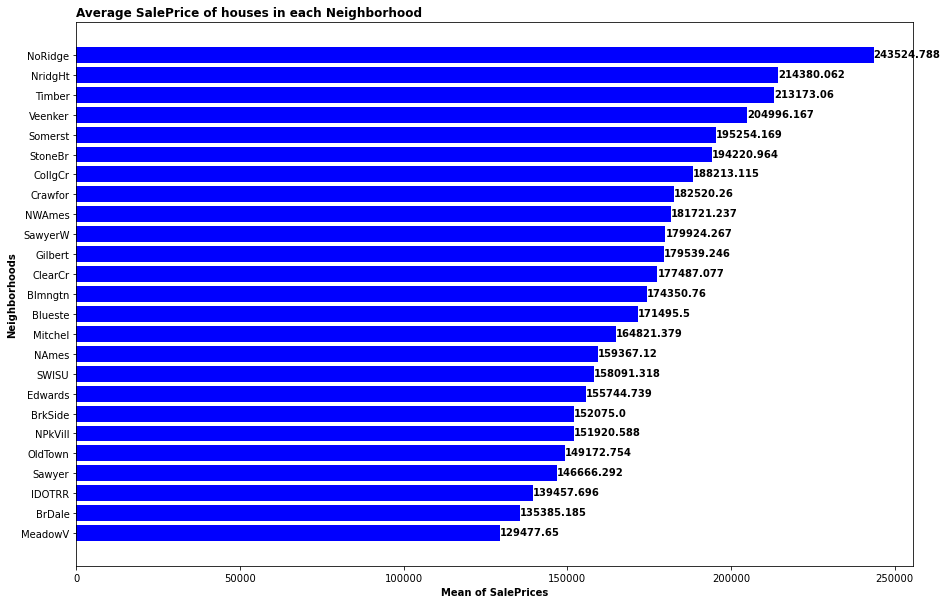

In [97]:
fig, ax = plt.subplots(figsize =(15,10))
ax.barh(range(len(y)), y['SalePrice'], color="blue")
plt.yticks(range(len(y)), y['Neighborhood'])
plt.xlabel('Mean of SalePrices', fontweight = 'bold')
plt.ylabel('Neighborhoods', fontweight = 'bold')
ax.set_title('Average SalePrice of houses in each Neighborhood', loc ='left', fontweight = 'bold')
for i in ax.patches:
    plt.text(i.get_width()+0.2, i.get_y()+0.3,
             str(round((i.get_width()), 3)),
             fontsize = 10, fontweight = 'bold',
             color ='black')
plt.show()

In [99]:
y.sort_values('SalePrice', axis=0, ascending=False, inplace=True, kind='quicksort', na_position='last', ignore_index=False, key=None)
y

,Neighborhood,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
15,NoRidge,1268.151515,56.363636,83.125472,11576.121212,7.727273,5.181818,1995.818182,1996.666667,290.000000,...,161.818182,73.696970,14.848485,0.000000,0.000000,0.0,0.000000,6.454545,2007.636364,243524.787879
16,NridgHt,1442.098214,68.571429,77.070691,10079.401786,7.991071,5.008929,2005.437500,2005.883929,253.223214,...,145.392857,72.500000,0.000000,0.000000,3.080357,0.0,0.000000,6.410714,2007.803571,214380.062500
23,Timber,1503.100000,39.400000,75.848927,11294.560000,7.320000,5.060000,2000.700000,2001.180000,146.500000,...,135.920000,45.440000,7.220000,0.000000,3.960000,0.0,0.000000,6.080000,2007.820000,213173.060000
24,Veenker,958.500000,50.000000,76.319564,11415.833333,6.000000,6.500000,1977.833333,1985.500000,93.333333,...,79.833333,67.833333,0.000000,0.000000,30.000000,0.0,0.000000,5.666667,2007.333333,204996.166667
21,Somerst,1440.352113,75.492958,64.013329,7388.140845,7.380282,5.021127,2004.626761,2004.936620,123.908451,...,79.647887,88.605634,0.000000,0.000000,1.267606,0.0,0.000000,6.126761,2007.922535,195254.169014
22,StoneBr,1550.107143,93.571429,61.639907,8411.071429,8.178571,5.000000,1997.285714,1997.500000,91.785714,...,129.071429,60.142857,21.464286,0.000000,30.000000,0.0,0.000000,7.464286,2007.750000,194220.964286
5,CollgCr,1444.842553,42.787234,71.012100,9897.068085,6.693617,5.221277,1998.319149,1999.246809,91.919149,...,115.391489,52.017021,0.144681,0.000000,2.097872,0.0,1.914894,6.148936,2007.634043,188213.114894
6,Crawfor,1517.820000,54.600000,71.396695,11116.620000,5.960000,6.380000,1935.260000,1974.840000,36.920000,...,53.760000,23.320000,42.760000,0.000000,16.200000,0.0,38.000000,6.140000,2007.600000,182520.260000
14,NWAmes,1408.039474,41.907895,76.118859,11586.157895,6.381579,5.842105,1976.065789,1979.868421,169.881579,...,107.105263,55.736842,8.407895,0.000000,9.934211,0.0,23.026316,5.605263,2007.907895,181721.236842
20,SawyerW,1379.613333,56.600000,68.746338,10011.386667,6.413333,5.146667,1990.480000,1993.333333,59.453333,...,112.693333,55.573333,7.773333,0.000000,7.413333,0.0,8.000000,5.973333,2008.053333,179924.266667


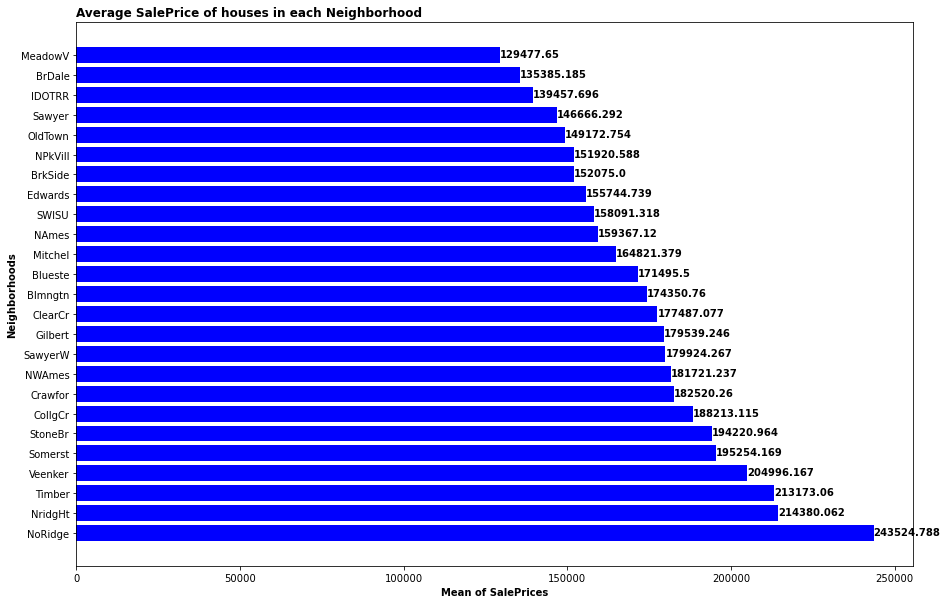

In [100]:
fig, ax = plt.subplots(figsize =(15,10))
ax.barh(range(len(y)), y['SalePrice'], color="blue")
plt.yticks(range(len(y)), y['Neighborhood'])
plt.xlabel('Mean of SalePrices', fontweight = 'bold')
plt.ylabel('Neighborhoods', fontweight = 'bold')
ax.set_title('Average SalePrice of houses in each Neighborhood', loc ='left', fontweight = 'bold')
for i in ax.patches:
    plt.text(i.get_width()+0.2, i.get_y()+0.3,
             str(round((i.get_width()), 3)),
             fontsize = 10, fontweight = 'bold',
             color ='black')
plt.show()

##### 2.

In [94]:
more_expensive = houseDataframe_noNULL_noOutlier_zscore.sort_values('SalePrice', axis=0, ascending=False, inplace=False, kind='quicksort', na_position='last', ignore_index=False, key=None)
more_expensive[['Id', 'SalePrice', 'Neighborhood']].head(10)

,Id,SalePrice,Neighborhood
1924,1925,381000,Timber
2545,2546,378500,Edwards
2430,2431,378500,NAmes
1388,1389,377500,Gilbert
1482,1483,377426,Gilbert
2883,2884,377426,Crawfor
336,337,377426,StoneBr
2338,2339,375000,Somerst
481,482,374000,NridgHt
2652,2653,372402,NridgHt


In [95]:
houseDataframe_noNULL_noOutlier_zscore['Neighborhood'].value_counts()

NAmes      267
CollgCr    235
Somerst    142
Gilbert    138
OldTown    126
Edwards    119
NridgHt    112
Sawyer      89
NWAmes      76
SawyerW     75
BrkSide     73
Mitchel     58
Crawfor     50
Timber      50
IDOTRR      46
NoRidge     33
StoneBr     28
BrDale      27
Blmngtn     25
SWISU       22
MeadowV     20
NPkVill     17
ClearCr     13
Blueste      8
Veenker      6
Name: Neighborhood, dtype: int64

##### 3.

###### -> pairPlot:

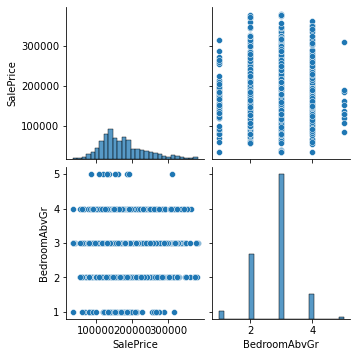

In [104]:
sns.pairplot(houseDataframe_noNULL_noOutlier_zscore[['SalePrice', 'BedroomAbvGr']])

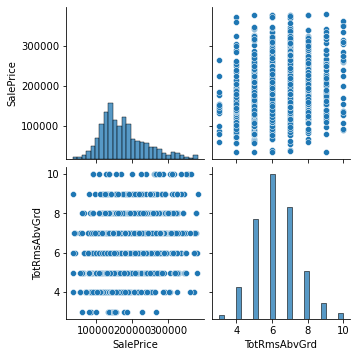

In [101]:
sns.pairplot(houseDataframe_noNULL_noOutlier_zscore[['SalePrice', 'TotRmsAbvGrd']])

###### -> scatterPlot:

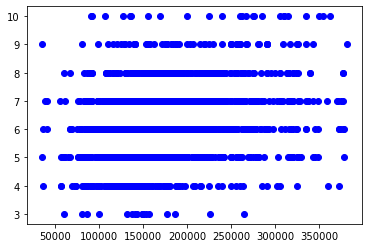

In [108]:
plt.scatter(houseDataframe_noNULL_noOutlier_zscore['SalePrice'], houseDataframe_noNULL_noOutlier_zscore['TotRmsAbvGrd'], c ="blue")
plt.show()

###### -> pearson correlation:

In [105]:
houseDataframe_noNULL_noOutlier_zscore[['SalePrice', 'TotRmsAbvGrd']].corr()

,SalePrice,TotRmsAbvGrd
SalePrice,1.000000,0.291969
TotRmsAbvGrd,0.291969,1.000000


###### -> spearman correlation:

In [107]:
houseDataframe_noNULL_noOutlier_zscore['SalePrice'].corr(houseDataframe_noNULL_noOutlier_zscore['TotRmsAbvGrd'], method = 'spearman')

0.3048754881085112

##### 4.

###### -> pairPlot:

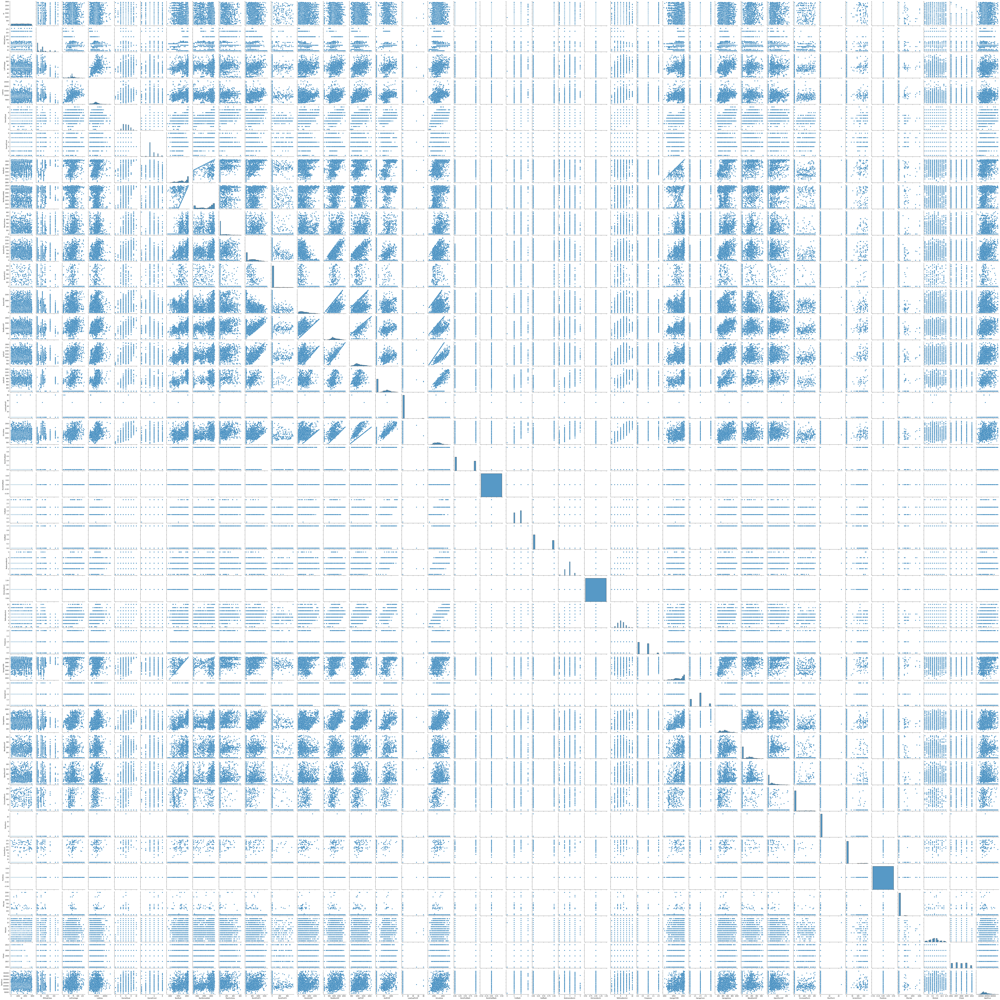

In [109]:
sns.pairplot(houseDataframe_noNULL_noOutlier_zscore)

###### -> heatmap:

<AxesSubplot:>

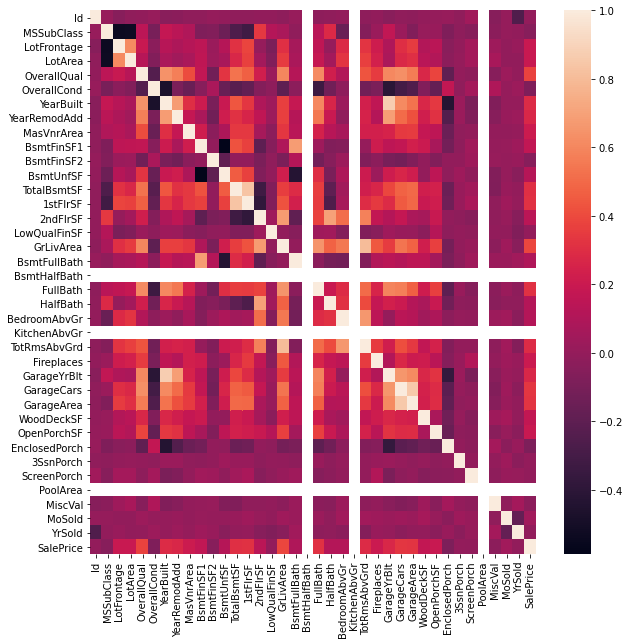

In [34]:
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(houseDataframe_noNULL_noOutlier_zscore.corr(), xticklabels=True, yticklabels=True)

###### -> pearson correlation:

In [23]:
houseDataframe_noNULL_noOutlier_zscore.corr()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
Id,1.000000,0.009644,-0.041532,-0.015107,-0.009804,0.013489,-0.037158,-0.034926,-0.014620,-0.012613,...,0.000864,0.007442,0.008760,-0.014823,0.046529,NaN,-0.045102,0.007791,-0.254070,-0.000630
MSSubClass,0.009644,1.000000,-0.533437,-0.525087,0.147650,-0.102524,0.179319,0.140459,0.103772,-0.072846,...,0.011059,0.019315,-0.072999,-0.020094,-0.047440,NaN,-0.031811,0.002546,-0.006036,-0.041977
LotFrontage,-0.041532,-0.533437,1.000000,0.610479,0.192962,-0.032301,0.128060,0.089210,0.123336,0.153589,...,0.107630,0.139104,-0.038341,-0.002530,0.062095,NaN,0.033852,-0.008793,0.015580,0.194486
LotArea,-0.015107,-0.525087,0.610479,1.000000,0.128889,-0.062987,0.087792,0.045772,0.078337,0.162251,...,0.133002,0.111791,-0.028074,0.007627,0.063345,NaN,0.075314,-0.004673,-0.006089,0.194890
OverallQual,-0.009804,0.147650,0.192962,0.128889,1.000000,-0.239820,0.645865,0.573351,0.405005,0.164837,...,0.272368,0.380184,-0.196256,-0.002390,-0.019910,NaN,-0.044659,0.029536,0.001583,0.375201
OverallCond,0.013489,-0.102524,-0.032301,-0.062987,-0.239820,1.000000,-0.472364,-0.088608,-0.155355,-0.047454,...,-0.068801,-0.175934,0.173624,-0.012826,0.062446,NaN,0.096508,0.002199,0.032581,-0.077522
YearBuilt,-0.037158,0.179319,0.128060,0.087792,0.645865,-0.472364,1.000000,0.678332,0.303908,0.209170,...,0.270257,0.336858,-0.437318,0.023643,-0.088194,NaN,-0.069591,0.007705,0.006462,0.292164
YearRemodAdd,-0.034926,0.140459,0.089210,0.045772,0.573351,-0.088608,0.678332,1.000000,0.175780,0.077580,...,0.230903,0.316584,-0.242990,0.022514,-0.071135,NaN,-0.044823,0.015582,0.032705,0.271956
MasVnrArea,-0.014620,0.103772,0.123336,0.078337,0.405005,-0.155355,0.303908,0.175780,1.000000,0.223559,...,0.177846,0.154897,-0.151363,-0.014864,0.001155,NaN,-0.000462,-0.001295,0.002661,0.208973
BsmtFinSF1,-0.012613,-0.072846,0.153589,0.162251,0.164837,-0.047454,0.209170,0.077580,0.223559,1.000000,...,0.205650,0.072690,-0.118866,-0.022254,0.050166,NaN,0.002983,0.008456,0.036202,0.165202


In [24]:
c = houseDataframe_noNULL_noOutlier_zscore.corr().abs()
s = c.unstack()
so = s.sort_values(kind="quicksort", ascending=False, na_position='last')
so[30:50]

MoSold        MoSold          1.000000
YrSold        YrSold          1.000000
LotFrontage   LotFrontage     1.000000
BsmtFullBath  BsmtFullBath    1.000000
SalePrice     SalePrice       1.000000
GarageYrBlt   YearBuilt       0.872805
YearBuilt     GarageYrBlt     0.872805
GarageArea    GarageCars      0.852404
GarageCars    GarageArea      0.852404
TotalBsmtSF   1stFlrSF        0.835231
1stFlrSF      TotalBsmtSF     0.835231
GrLivArea     TotRmsAbvGrd    0.806731
TotRmsAbvGrd  GrLivArea       0.806731
HalfBath      2ndFlrSF        0.701133
2ndFlrSF      HalfBath        0.701133
YearRemodAdd  GarageYrBlt     0.686989
GarageYrBlt   YearRemodAdd    0.686989
BsmtFinSF1    BsmtFullBath    0.681065
BsmtFullBath  BsmtFinSF1      0.681065
YearBuilt     YearRemodAdd    0.678332
dtype: float64

###### -> scatterPlot:

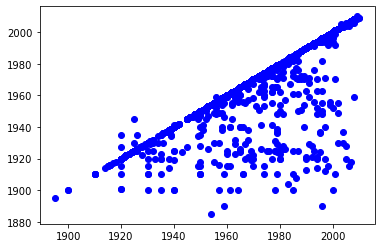

In [35]:
plt.scatter(houseDataframe_noNULL_noOutlier_zscore['GarageYrBlt'], houseDataframe_noNULL_noOutlier_zscore['YearBuilt'], c ="blue")
plt.show()

##### 5.

###### -> boxPlot:

<AxesSubplot:xlabel='SalePrice'>

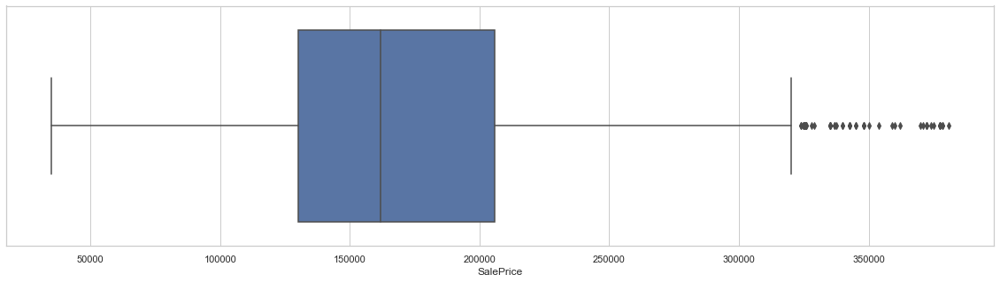

In [43]:
plt.rcParams["figure.figsize"] = [20, 5]
sns.set_theme(style="whitegrid")
sns.boxplot(x=houseDataframe_noNULL_noOutlier_zscore["SalePrice"])

###### -> histogram:

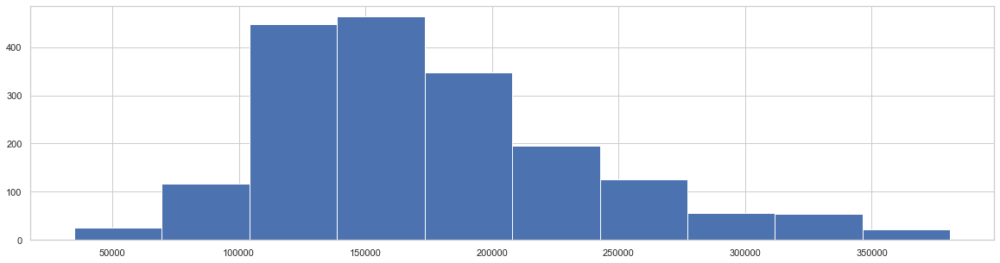

In [44]:
plt.hist(houseDataframe_noNULL_noOutlier_zscore["SalePrice"])
plt.show() 

###### -> distribution plot:

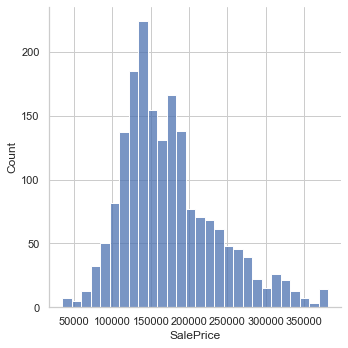

In [48]:
sns.displot(houseDataframe_noNULL_noOutlier_zscore["SalePrice"])

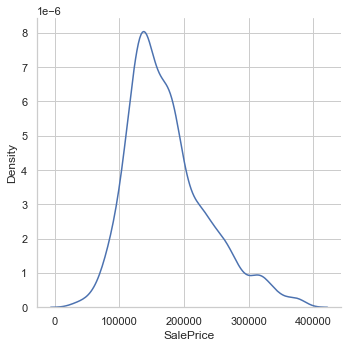

In [49]:
sns.displot(houseDataframe_noNULL_noOutlier_zscore["SalePrice"], kind="kde")

##### 6.

<AxesSubplot:xlabel='SalePrice', ylabel='YearBuilt'>

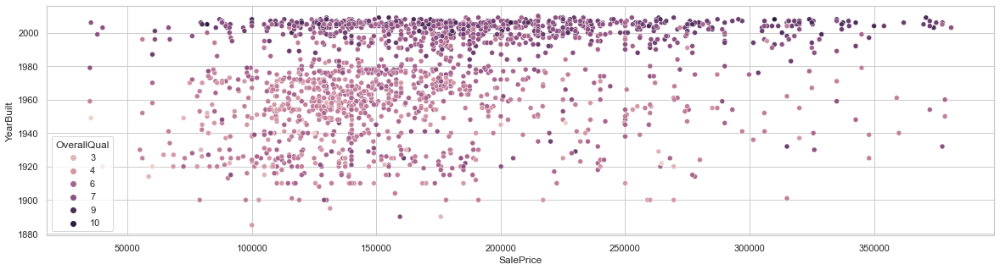

In [62]:
sns.scatterplot(x="SalePrice", y="YearBuilt", hue="OverallQual", data=houseDataframe_noNULL_noOutlier_zscore)

# Question 2:

In [321]:
purchasesDataset = pd.read_csv(purchasesDatasetPath)
usersDataset = pd.read_csv(usersDatasetPath)

In [322]:
purchasesDataframe = pd.DataFrame(purchasesDataset);
usersDataframe = pd.DataFrame(usersDataset);

In [6]:
purchasesDataframe

,user_id,SKU,AddedTime,Price,CurrencyISO
0,6192636,personal_offer_starter_pack,2023-01-31 13:16:55.991756+00:00,2.29,GBP
1,5954105,bundle_pack_1,2023-01-06 19:20:33.631714+00:00,1.79,EUR
2,5954105,coin_pack_1,2023-01-07 15:56:47.792655+00:00,0.79,EUR
3,5903715,bundle_pack_1,2023-01-01 18:48:38.391356+00:00,1.99,USD
4,5984323,golden_ticket_season_pass,2023-01-11 21:13:47.161073+00:00,9.99,USD
...,...,...,...,...,...
1408,5964679,bundle_pack_1,2023-02-01 13:13:43.680081+00:00,1.49,USD
1409,5964679,coin_pack_1,2023-01-19 13:51:50.503887+00:00,0.99,USD
1410,5964679,bundle_pack_1,2023-02-04 23:15:25.865344+00:00,1.49,USD
1411,5964679,coin_pack_1,2023-01-20 15:43:32.899227+00:00,0.99,USD


In [7]:
usersDataframe

,user_id,registered_time,country_code
0,6184936,2023-01-29 16:17:17.843502+01:00,GB
1,6264057,2023-02-07 19:02:41.585439+01:00,CU
2,5993230,2023-01-10 20:36:11.105080+01:00,BD
3,6209389,2023-02-01 18:22:22.899987+01:00,GR
4,6066178,2023-01-17 17:01:09.590550+01:00,TR
...,...,...,...
56509,5983087,2023-01-09 16:36:16.596704+01:00,CN
56510,6132178,2023-01-24 15:28:11.102926+01:00,GB
56511,5968220,2023-01-07 15:21:56.387803+01:00,AF
56512,6221518,2023-02-02 22:07:30.089388+01:00,IQ


### - preprocessing:

##### 1.

In [8]:
purchasesDataframe['AddedTime'] = pd.to_datetime( purchasesDataframe['AddedTime'] )
purchasesDataframe

,user_id,SKU,AddedTime,Price,CurrencyISO
0,6192636,personal_offer_starter_pack,2023-01-31 13:16:55.991756+00:00,2.29,GBP
1,5954105,bundle_pack_1,2023-01-06 19:20:33.631714+00:00,1.79,EUR
2,5954105,coin_pack_1,2023-01-07 15:56:47.792655+00:00,0.79,EUR
3,5903715,bundle_pack_1,2023-01-01 18:48:38.391356+00:00,1.99,USD
4,5984323,golden_ticket_season_pass,2023-01-11 21:13:47.161073+00:00,9.99,USD
...,...,...,...,...,...
1408,5964679,bundle_pack_1,2023-02-01 13:13:43.680081+00:00,1.49,USD
1409,5964679,coin_pack_1,2023-01-19 13:51:50.503887+00:00,0.99,USD
1410,5964679,bundle_pack_1,2023-02-04 23:15:25.865344+00:00,1.49,USD
1411,5964679,coin_pack_1,2023-01-20 15:43:32.899227+00:00,0.99,USD


In [121]:
url = 'https://v6.exchangerate-api.com/v6/bd53642b295f95f92930113c/latest/USD'

response = requests.get(url)
data = response.json();

print(data)

{'result': 'success', 'documentation': 'https://www.exchangerate-api.com/docs', 'terms_of_use': 'https://www.exchangerate-api.com/terms', 'time_last_update_unix': 1678924802, 'time_last_update_utc': 'Thu, 16 Mar 2023 00:00:02 +0000', 'time_next_update_unix': 1679011202, 'time_next_update_utc': 'Fri, 17 Mar 2023 00:00:02 +0000', 'base_code': 'USD', 'conversion_rates': {'USD': 1, 'AED': 3.6725, 'AFN': 88.4777, 'ALL': 107.2745, 'AMD': 388.4048, 'ANG': 1.79, 'AOA': 511.6764, 'ARS': 203.0845, 'AUD': 1.5085, 'AWG': 1.79, 'AZN': 1.7026, 'BAM': 1.8503, 'BBD': 2.0, 'BDT': 106.5337, 'BGN': 1.8507, 'BHD': 0.376, 'BIF': 2079.6639, 'BMD': 1.0, 'BND': 1.3518, 'BOB': 6.9479, 'BRL': 5.2679, 'BSD': 1.0, 'BTN': 82.8088, 'BWP': 13.3549, 'BYN': 2.6396, 'BZD': 2.0, 'CAD': 1.3771, 'CDF': 2070.1865, 'CHF': 0.9276, 'CLP': 804.7237, 'CNY': 6.9037, 'COP': 4754.7945, 'CRC': 549.1334, 'CUP': 24.0, 'CVE': 104.3167, 'CZK': 22.6614, 'DJF': 177.721, 'DKK': 7.0579, 'DOP': 55.2378, 'DZD': 136.574, 'EGP': 30.9544, 'ERN'

In [9]:
print(purchasesDataframe.dtypes)

user_id                      int64
SKU                         object
AddedTime      datetime64[ns, UTC]
Price                      float64
CurrencyISO                 object
dtype: object


In [10]:
purchasesDataframe['CurrencyISO'] = purchasesDataframe['CurrencyISO'].astype("category")

In [11]:
print(purchasesDataframe['CurrencyISO'].cat.categories)

Index(['AUD', 'CAD', 'CHF', 'DKK', 'EUR', 'GBP', 'HUF', 'IDR', 'ILS', 'JPY',
       'MXN', 'MYR', 'NOK', 'PHP', 'PLN', 'SEK', 'USD', 'ZAR'],
      dtype='object')


In [12]:
purchasesDataframe["USD_Price"] = 0
purchasesDataframe

,user_id,SKU,AddedTime,Price,CurrencyISO,USD_Price
0,6192636,personal_offer_starter_pack,2023-01-31 13:16:55.991756+00:00,2.29,GBP,0
1,5954105,bundle_pack_1,2023-01-06 19:20:33.631714+00:00,1.79,EUR,0
2,5954105,coin_pack_1,2023-01-07 15:56:47.792655+00:00,0.79,EUR,0
3,5903715,bundle_pack_1,2023-01-01 18:48:38.391356+00:00,1.99,USD,0
4,5984323,golden_ticket_season_pass,2023-01-11 21:13:47.161073+00:00,9.99,USD,0
...,...,...,...,...,...,...
1408,5964679,bundle_pack_1,2023-02-01 13:13:43.680081+00:00,1.49,USD,0
1409,5964679,coin_pack_1,2023-01-19 13:51:50.503887+00:00,0.99,USD,0
1410,5964679,bundle_pack_1,2023-02-04 23:15:25.865344+00:00,1.49,USD,0
1411,5964679,coin_pack_1,2023-01-20 15:43:32.899227+00:00,0.99,USD,0


In [13]:
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'AUD',
                                           purchasesDataframe['Price'] / 1.5085,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'CAD',
                                           purchasesDataframe['Price'] / 1.3771,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'CHF',
                                           purchasesDataframe['Price'] / 0.9276,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'DKK',
                                           purchasesDataframe['Price'] / 7.0579,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'EUR',
                                           purchasesDataframe['Price'] / 0.9461,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'GBP',
                                           purchasesDataframe['Price'] / 0.8295,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'HUF',
                                           purchasesDataframe['Price'] / 374.3794,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'IDR',
                                           purchasesDataframe['Price'] / 15409.607,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'ILS',
                                           purchasesDataframe['Price'] / 3.6362,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'JPY',
                                           purchasesDataframe['Price'] / 133.0424,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'ILS',
                                           purchasesDataframe['Price'] / 3.6362,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'MXN',
                                           purchasesDataframe['Price'] / 18.9941,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'MYR',
                                           purchasesDataframe['Price'] / 4.4817,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'NOK',
                                           purchasesDataframe['Price'] / 10.7638,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'PHP',
                                           purchasesDataframe['Price'] / 55.0215,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'PLN',
                                           purchasesDataframe['Price'] / 4.4385,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'SEK',
                                           purchasesDataframe['Price'] / 10.6054,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'USD',
                                           purchasesDataframe['Price'] / 1,
                                           purchasesDataframe['USD_Price'])
purchasesDataframe['USD_Price'] = np.where(purchasesDataframe['CurrencyISO'] == 'ZAR',
                                           purchasesDataframe['Price'] / 18.4039,
                                           purchasesDataframe['USD_Price'])

In [14]:
purchasesDataframe

,user_id,SKU,AddedTime,Price,CurrencyISO,USD_Price
0,6192636,personal_offer_starter_pack,2023-01-31 13:16:55.991756+00:00,2.29,GBP,2.760699
1,5954105,bundle_pack_1,2023-01-06 19:20:33.631714+00:00,1.79,EUR,1.891978
2,5954105,coin_pack_1,2023-01-07 15:56:47.792655+00:00,0.79,EUR,0.835007
3,5903715,bundle_pack_1,2023-01-01 18:48:38.391356+00:00,1.99,USD,1.990000
4,5984323,golden_ticket_season_pass,2023-01-11 21:13:47.161073+00:00,9.99,USD,9.990000
...,...,...,...,...,...,...
1408,5964679,bundle_pack_1,2023-02-01 13:13:43.680081+00:00,1.49,USD,1.490000
1409,5964679,coin_pack_1,2023-01-19 13:51:50.503887+00:00,0.99,USD,0.990000
1410,5964679,bundle_pack_1,2023-02-04 23:15:25.865344+00:00,1.49,USD,1.490000
1411,5964679,coin_pack_1,2023-01-20 15:43:32.899227+00:00,0.99,USD,0.990000


###### 2.

In [100]:
purchase_user_dataframe = pd.merge(purchasesDataframe, usersDataframe, on='user_id', how='outer')
purchase_user_dataframe

,user_id,SKU,AddedTime,Price,CurrencyISO,USD_Price,date,registered_time,country_code
0,6192636,personal_offer_starter_pack,2023-01-31 13:16:55.991756+00:00,2.29,GBP,2.760699,2023-01-24 13:16:55.991756+00:00,2023-01-30 16:12:02.731706+01:00,GB
1,5954105,bundle_pack_1,2023-01-06 19:20:33.631714+00:00,1.79,EUR,1.891978,2022-12-30 19:20:33.631714+00:00,2023-01-05 20:33:54.584158+01:00,BE
2,5954105,coin_pack_1,2023-01-07 15:56:47.792655+00:00,0.79,EUR,0.835007,2022-12-31 15:56:47.792655+00:00,2023-01-05 20:33:54.584158+01:00,BE
3,5903715,bundle_pack_1,2023-01-01 18:48:38.391356+00:00,1.99,USD,1.990000,2022-12-25 18:48:38.391356+00:00,2022-12-30 18:47:41.108888+01:00,US
4,5984323,golden_ticket_season_pass,2023-01-11 21:13:47.161073+00:00,9.99,USD,9.990000,2023-01-04 21:13:47.161073+00:00,2023-01-09 18:57:06.353154+01:00,US
...,...,...,...,...,...,...,...,...,...
57617,5983087,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-09 16:36:16.596704+01:00,CN
57618,6132178,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-24 15:28:11.102926+01:00,GB
57619,5968220,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-07 15:21:56.387803+01:00,AF
57620,6221518,NaN,NaT,NaN,NaN,NaN,NaT,2023-02-02 22:07:30.089388+01:00,IQ


### - visualizing:

##### 1.

In [101]:
purchase_user_dataframe['AddedTime'] = purchase_user_dataframe['AddedTime'].dt.date
purchase_user_dataframe

,user_id,SKU,AddedTime,Price,CurrencyISO,USD_Price,date,registered_time,country_code
0,6192636,personal_offer_starter_pack,2023-01-31,2.29,GBP,2.760699,2023-01-24 13:16:55.991756+00:00,2023-01-30 16:12:02.731706+01:00,GB
1,5954105,bundle_pack_1,2023-01-06,1.79,EUR,1.891978,2022-12-30 19:20:33.631714+00:00,2023-01-05 20:33:54.584158+01:00,BE
2,5954105,coin_pack_1,2023-01-07,0.79,EUR,0.835007,2022-12-31 15:56:47.792655+00:00,2023-01-05 20:33:54.584158+01:00,BE
3,5903715,bundle_pack_1,2023-01-01,1.99,USD,1.990000,2022-12-25 18:48:38.391356+00:00,2022-12-30 18:47:41.108888+01:00,US
4,5984323,golden_ticket_season_pass,2023-01-11,9.99,USD,9.990000,2023-01-04 21:13:47.161073+00:00,2023-01-09 18:57:06.353154+01:00,US
...,...,...,...,...,...,...,...,...,...
57617,5983087,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-09 16:36:16.596704+01:00,CN
57618,6132178,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-24 15:28:11.102926+01:00,GB
57619,5968220,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-07 15:21:56.387803+01:00,AF
57620,6221518,NaN,NaT,NaN,NaN,NaN,NaT,2023-02-02 22:07:30.089388+01:00,IQ


In [102]:
purchase_user_dataframe["AddedTime"].dtype

dtype('O')

<AxesSubplot:xlabel='AddedTime'>

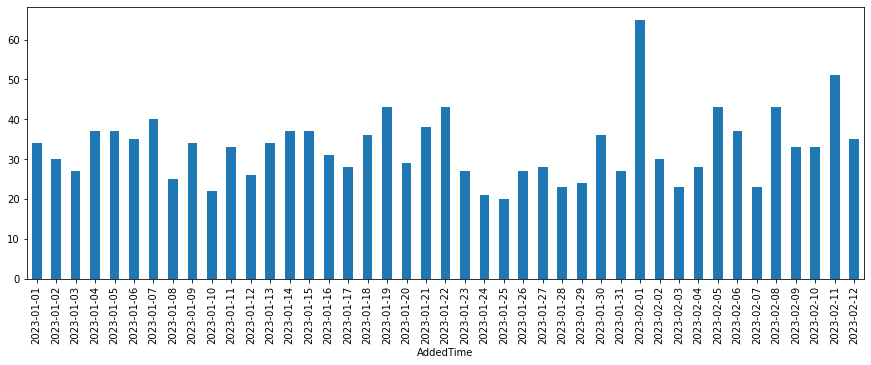

In [103]:
fig, ax = plt.subplots(figsize=(15, 5))
purchase_user_dataframe["AddedTime"].groupby(purchase_user_dataframe.AddedTime).count().plot(kind="bar")

##### 2.

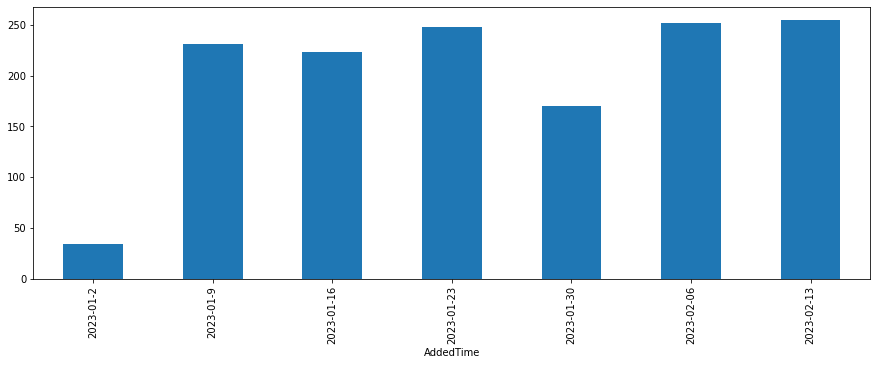

In [122]:
fig, ax = plt.subplots(figsize =(15,5))
purchasesDataframe.groupby([pd.Grouper(key='AddedTime', freq='W-SUN')])['AddedTime'].count().plot(kind="bar")
plt.xticks([0, 1, 2, 3, 4, 5, 6], ['2023-01-2', '2023-01-9', '2023-01-16', '2023-01-23', '2023-01-30', '2023-02-06', '2023-02-13'])
plt.show()

In [135]:
weekly = purchasesDataframe.groupby([pd.Grouper(key='AddedTime', freq='W')])['AddedTime'].count().sort_values(ascending=False)
weekly

AddedTime
2023-02-12 00:00:00+00:00    255
2023-02-05 00:00:00+00:00    252
2023-01-22 00:00:00+00:00    248
2023-01-08 00:00:00+00:00    231
2023-01-15 00:00:00+00:00    223
2023-01-29 00:00:00+00:00    170
2023-01-01 00:00:00+00:00     34
Name: AddedTime, dtype: int64

<AxesSubplot:xlabel='AddedTime'>

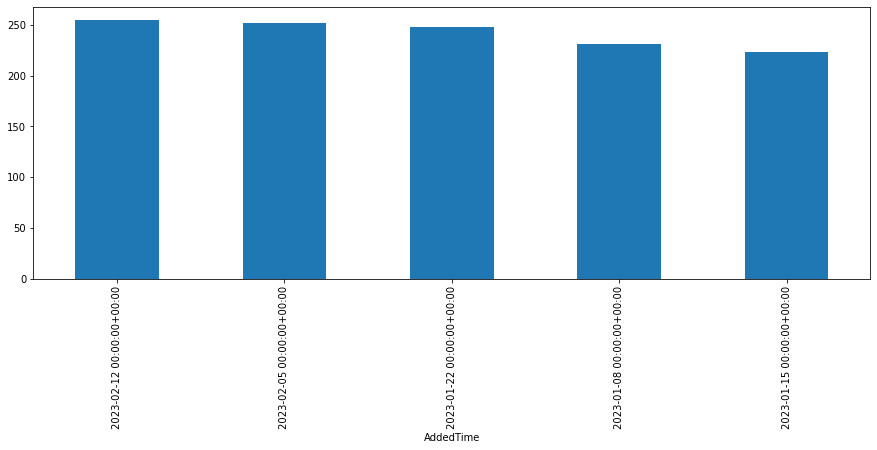

In [138]:
fig, ax = plt.subplots(figsize =(15,5))
purchasesDataframe.groupby([pd.Grouper(key='AddedTime', freq='W-SUN')])['AddedTime'].count().sort_values(ascending=False)[:5].plot(kind='bar')

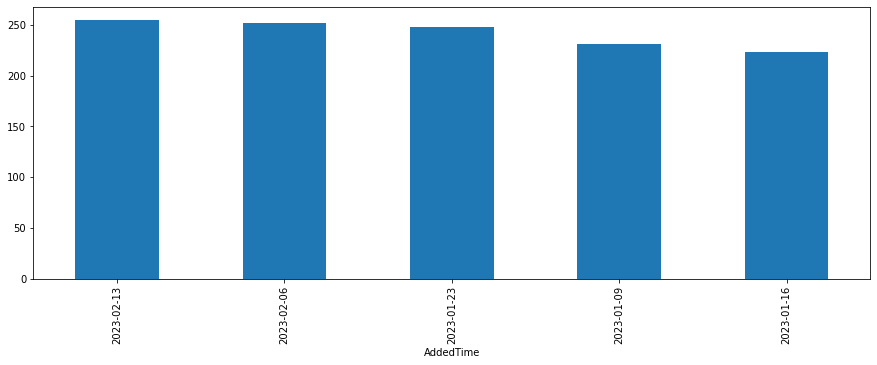

In [140]:
fig, ax = plt.subplots(figsize =(15,5))
purchasesDataframe.groupby([pd.Grouper(key='AddedTime', freq='W-SUN')])['AddedTime'].count().sort_values(ascending=False)[:5].plot(kind='bar')
plt.xticks([0, 1, 2, 3, 4], ['2023-02-13', '2023-02-06', '2023-01-23', '2023-01-09', '2023-01-16'])
plt.show()

##### 3.

In [143]:
purchase_user_dataframe = pd.merge(purchasesDataframe, usersDataframe, on='user_id', how='outer')
purchase_user_dataframe

,user_id,SKU,AddedTime,Price,CurrencyISO,USD_Price,date,registered_time,country_code
0,6192636,personal_offer_starter_pack,2023-01-31 13:16:55.991756+00:00,2.29,GBP,2.760699,2023-01-24 13:16:55.991756+00:00,2023-01-30 16:12:02.731706+01:00,GB
1,5954105,bundle_pack_1,2023-01-06 19:20:33.631714+00:00,1.79,EUR,1.891978,2022-12-30 19:20:33.631714+00:00,2023-01-05 20:33:54.584158+01:00,BE
2,5954105,coin_pack_1,2023-01-07 15:56:47.792655+00:00,0.79,EUR,0.835007,2022-12-31 15:56:47.792655+00:00,2023-01-05 20:33:54.584158+01:00,BE
3,5903715,bundle_pack_1,2023-01-01 18:48:38.391356+00:00,1.99,USD,1.990000,2022-12-25 18:48:38.391356+00:00,2022-12-30 18:47:41.108888+01:00,US
4,5984323,golden_ticket_season_pass,2023-01-11 21:13:47.161073+00:00,9.99,USD,9.990000,2023-01-04 21:13:47.161073+00:00,2023-01-09 18:57:06.353154+01:00,US
...,...,...,...,...,...,...,...,...,...
57617,5983087,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-09 16:36:16.596704+01:00,CN
57618,6132178,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-24 15:28:11.102926+01:00,GB
57619,5968220,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-07 15:21:56.387803+01:00,AF
57620,6221518,NaN,NaT,NaN,NaN,NaN,NaT,2023-02-02 22:07:30.089388+01:00,IQ


In [144]:
purchase_user_dataframe['day_of_week'] = purchase_user_dataframe['AddedTime'].dt.day_name()
purchase_user_dataframe

,user_id,SKU,AddedTime,Price,CurrencyISO,USD_Price,date,registered_time,country_code,day_of_week
0,6192636,personal_offer_starter_pack,2023-01-31 13:16:55.991756+00:00,2.29,GBP,2.760699,2023-01-24 13:16:55.991756+00:00,2023-01-30 16:12:02.731706+01:00,GB,Tuesday
1,5954105,bundle_pack_1,2023-01-06 19:20:33.631714+00:00,1.79,EUR,1.891978,2022-12-30 19:20:33.631714+00:00,2023-01-05 20:33:54.584158+01:00,BE,Friday
2,5954105,coin_pack_1,2023-01-07 15:56:47.792655+00:00,0.79,EUR,0.835007,2022-12-31 15:56:47.792655+00:00,2023-01-05 20:33:54.584158+01:00,BE,Saturday
3,5903715,bundle_pack_1,2023-01-01 18:48:38.391356+00:00,1.99,USD,1.990000,2022-12-25 18:48:38.391356+00:00,2022-12-30 18:47:41.108888+01:00,US,Sunday
4,5984323,golden_ticket_season_pass,2023-01-11 21:13:47.161073+00:00,9.99,USD,9.990000,2023-01-04 21:13:47.161073+00:00,2023-01-09 18:57:06.353154+01:00,US,Wednesday
...,...,...,...,...,...,...,...,...,...,...
57617,5983087,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-09 16:36:16.596704+01:00,CN,NaN
57618,6132178,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-24 15:28:11.102926+01:00,GB,NaN
57619,5968220,NaN,NaT,NaN,NaN,NaN,NaT,2023-01-07 15:21:56.387803+01:00,AF,NaN
57620,6221518,NaN,NaT,NaN,NaN,NaN,NaT,2023-02-02 22:07:30.089388+01:00,IQ,NaN


In [147]:
purchase_user_dataframe["day_of_week"].groupby(purchase_user_dataframe.day_of_week).count().sort_values(ascending=False)

day_of_week
Sunday       241
Wednesday    234
Saturday     217
Thursday     196
Monday       195
Friday       182
Tuesday      148
Name: day_of_week, dtype: int64

<AxesSubplot:xlabel='day_of_week'>

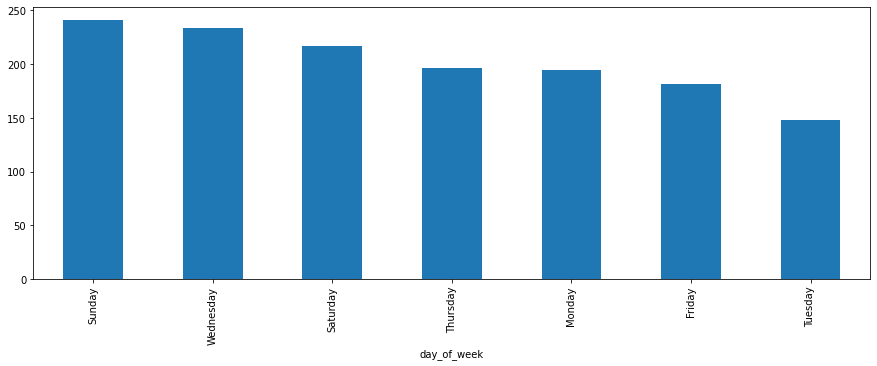

In [148]:
fig, ax = plt.subplots(figsize=(15, 5))
purchase_user_dataframe["day_of_week"].groupby(purchase_user_dataframe.day_of_week).count().sort_values(ascending=False).plot(kind="bar")

##### 4.

In [155]:
purchase_user_dataframe["user_id"].groupby(purchase_user_dataframe.user_id).count().sort_values(ascending=False).head(10)

user_id
2474953    50
6039515    36
5394301    29
4913028    28
6294656    27
1507884    25
6029577    25
4627239    24
3265117    23
5991949    22
Name: user_id, dtype: int64

In [154]:
purchase_user_dataframe[purchase_user_dataframe['user_id'] == 2474953]

,user_id,SKU,AddedTime,Price,CurrencyISO,USD_Price,date,registered_time,country_code,day_of_week
988,2474953,bundle_pack_4,2023-01-20 22:22:39.566281+00:00,12.99,USD,12.99,2023-01-13 22:22:39.566281+00:00,2021-10-10 01:51:08.762136+02:00,US,Friday
989,2474953,bundle_pack_4,2023-01-24 18:36:35.811781+00:00,12.99,USD,12.99,2023-01-17 18:36:35.811781+00:00,2021-10-10 01:51:08.762136+02:00,US,Tuesday
990,2474953,bundle_pack_4,2023-02-04 23:21:41.269265+00:00,12.99,USD,12.99,2023-01-28 23:21:41.269265+00:00,2021-10-10 01:51:08.762136+02:00,US,Saturday
991,2474953,piggy_bank,2023-02-07 18:52:44.806891+00:00,1.49,USD,1.49,2023-01-31 18:52:44.806891+00:00,2021-10-10 01:51:08.762136+02:00,US,Tuesday
992,2474953,bundle_pack_4,2023-02-03 20:38:27.776901+00:00,12.99,USD,12.99,2023-01-27 20:38:27.776901+00:00,2021-10-10 01:51:08.762136+02:00,US,Friday
993,2474953,bundle_pack_5,2023-02-11 00:05:56.227758+00:00,23.99,USD,23.99,2023-02-04 00:05:56.227758+00:00,2021-10-10 01:51:08.762136+02:00,US,Saturday
994,2474953,piggy_bank,2023-02-01 20:25:03.713254+00:00,1.49,USD,1.49,2023-01-25 20:25:03.713254+00:00,2021-10-10 01:51:08.762136+02:00,US,Wednesday
995,2474953,bundle_pack_5,2023-01-28 00:58:40.901499+00:00,23.99,USD,23.99,2023-01-21 00:58:40.901499+00:00,2021-10-10 01:51:08.762136+02:00,US,Saturday
996,2474953,bundle_pack_4,2023-01-30 18:18:20.635309+00:00,12.99,USD,12.99,2023-01-23 18:18:20.635309+00:00,2021-10-10 01:51:08.762136+02:00,US,Monday
997,2474953,bundle_pack_2,2023-01-26 10:02:27.561904+00:00,2.99,USD,2.99,2023-01-19 10:02:27.561904+00:00,2021-10-10 01:51:08.762136+02:00,US,Thursday


In [157]:
usersDataframe[usersDataframe['user_id'] == 2474953]

,user_id,registered_time,country_code
49302,2474953,2021-10-10 01:51:08.762136+02:00,US


##### 5.

In [161]:
usersDataframe["country_code"].groupby(usersDataframe.country_code).count().sort_values(ascending=True).head(20)

country_code
AD    1
LI    1
KI    1
FM    1
BB    1
TK    1
FO    1
TO    1
GG    1
VI    1
GU    1
AG    1
YT    1
GW    1
SB    1
IM    2
GQ    2
IS    2
GI    2
CV    2
Name: country_code, dtype: int64

In [166]:
usersDataframe["country_code"].groupby(usersDataframe.country_code).count().sort_values(ascending=True).head(15)

country_code
AD    1
LI    1
KI    1
FM    1
BB    1
TK    1
FO    1
TO    1
GG    1
VI    1
GU    1
AG    1
YT    1
GW    1
SB    1
Name: country_code, dtype: int64

##### 6.

In [173]:
purchase_user_dataframe["USD_Price"].groupby(purchase_user_dataframe.country_code).sum().sort_values(ascending=False).head(5)

country_code
US    4226.720000
GB     378.722122
AU     248.127279
DE     207.183281
CA     128.843221
Name: USD_Price, dtype: float64

##### 7.

In [189]:
purchase_user_dataframe["USD_Price"].groupby(purchase_user_dataframe.user_id).sum().sort_values(ascending=False).head(30)

user_id
2474953    411.000000
3265117    235.270000
6029577    146.750000
5942278    145.780000
1507884    145.750000
5906035    123.820000
6003692    117.870000
1826109    109.870000
5516081    100.800000
6110959     98.870000
4787007     97.930000
5991949     97.780000
5481706     94.850000
4913028     91.720000
5394301     88.710000
5034999     82.870000
6136674     81.900000
5678422     72.847199
2917624     69.800000
3287387     68.910000
5840919     66.401447
6018546     65.320000
3887821     63.980000
6188096     62.980000
4544433     61.930000
3031821     60.342459
5657748     57.430000
5834738     51.900000
5467091     50.870000
6070686     49.950000
Name: USD_Price, dtype: float64

In [196]:
usersDataframe[usersDataframe['user_id'] == 2474953    ]

,user_id,registered_time,country_code
49302,2474953,2021-10-10 01:51:08.762136+02:00,US


In [197]:
usersDataframe[usersDataframe['user_id'] == 3265117    ]

,user_id,registered_time,country_code
51139,3265117,2022-01-20 19:26:04.577517+01:00,US


In [198]:
usersDataframe[usersDataframe['user_id'] == 6029577    ]

,user_id,registered_time,country_code
34217,6029577,2023-01-14 03:31:57.876848+01:00,US


In [199]:
usersDataframe[usersDataframe['user_id'] == 5942278    ]

,user_id,registered_time,country_code
37540,5942278,2023-01-04 15:57:12.140747+01:00,US


In [200]:
usersDataframe[usersDataframe['user_id'] == 1507884    ]

,user_id,registered_time,country_code
34440,1507884,2021-04-13 01:05:27.393719+02:00,US


In [201]:
usersDataframe[usersDataframe['user_id'] == 5906035    ]

,user_id,registered_time,country_code
43044,5906035,2022-12-31 03:09:34.745092+01:00,DE


In [202]:
usersDataframe[usersDataframe['user_id'] == 6003692    ]

,user_id,registered_time,country_code
34435,6003692,2023-01-12 01:21:09.179941+01:00,US


In [203]:
usersDataframe[usersDataframe['user_id'] == 1826109    ]

,user_id,registered_time,country_code
36659,1826109,2021-06-14 23:55:41.210643+02:00,US


In [204]:
usersDataframe[usersDataframe['user_id'] == 5516081    ]

,user_id,registered_time,country_code
46082,5516081,2022-11-02 03:36:28.117731+01:00,US


In [205]:
usersDataframe[usersDataframe['user_id'] == 6110959    ]

,user_id,registered_time,country_code
37507,6110959,2023-01-22 01:46:40.173782+01:00,US


In [206]:
usersDataframe[usersDataframe['user_id'] == 4787007    ]

,user_id,registered_time,country_code
30179,4787007,2022-08-08 03:10:11.465584+02:00,US


In [207]:
usersDataframe[usersDataframe['user_id'] == 5991949    ]

,user_id,registered_time,country_code
32001,5991949,2023-01-10 18:25:15.991256+01:00,US


In [208]:
usersDataframe[usersDataframe['user_id'] == 5481706    ]

,user_id,registered_time,country_code
49865,5481706,2022-10-28 00:10:49.091982+02:00,US


In [209]:
usersDataframe[usersDataframe['user_id'] == 4913028    ]

,user_id,registered_time,country_code
46691,4913028,2022-08-21 00:26:35.131658+02:00,US


In [210]:
usersDataframe[usersDataframe['user_id'] == 5394301    ]     

,user_id,registered_time,country_code
36852,5394301,2022-10-17 05:54:50.820948+02:00,US


##### 8.

In [213]:
pd.set_option('display.max_rows', 500)

In [214]:
purchase_user_dataframe["user_id"].groupby(purchase_user_dataframe.country_code).count().sort_values(ascending=False)

country_code
IN    6960
US    5585
AF    4799
PK    2316
TR    2274
RU    2262
ID    2124
BR    1833
IQ    1660
EG    1563
DE    1556
CU    1393
GB    1308
PH    1083
FR    1013
SY     995
BD     825
IT     801
RO     698
ES     633
TH     588
UA     582
CA     456
MY     454
AE     450
PL     439
MM     411
MX     407
ZA     382
DZ     362
AR     362
UZ     339
SO     332
NL     321
VN     318
JP     302
AU     291
RS     264
SG     258
MA     256
GR     247
HU     244
KR     243
CO     226
SA     222
CZ     214
KZ     197
CN     194
NG     191
BE     180
AZ     173
JO     170
PT     166
GH     156
AT     156
YE     156
LK     153
LB     148
BG     147
SS     139
VE     138
LY     127
SN     126
CL     121
SE     115
KH     114
ET     114
DO     112
SD     110
NP     103
TW      97
SK      95
HK      95
AL      93
TN      92
IL      88
PS      86
BY      86
GE      82
CH      82
LT      81
PE      75
DK      75
HT      71
CI      70
KG      64
HR      62
KE      62
TJ      58
NZ      

##### 9.

In [323]:
groups = usersDataframe["user_id"].groupby(usersDataframe.country_code).count().sort_values(ascending=False)
groups.head(5)

country_code
IN    6960
US    4848
AF    4799
PK    2316
TR    2274
Name: user_id, dtype: int64

In [324]:
usersDataframe["user_count"] = ''
usersDataframe

,user_id,registered_time,country_code,user_count
0,6184936,2023-01-29 16:17:17.843502+01:00,GB,
1,6264057,2023-02-07 19:02:41.585439+01:00,CU,
2,5993230,2023-01-10 20:36:11.105080+01:00,BD,
3,6209389,2023-02-01 18:22:22.899987+01:00,GR,
4,6066178,2023-01-17 17:01:09.590550+01:00,TR,
...,...,...,...,...
56509,5983087,2023-01-09 16:36:16.596704+01:00,CN,
56510,6132178,2023-01-24 15:28:11.102926+01:00,GB,
56511,5968220,2023-01-07 15:21:56.387803+01:00,AF,
56512,6221518,2023-02-02 22:07:30.089388+01:00,IQ,


In [326]:
keys = groups.keys()

for i, j in zip(keys, groups):
    for index, row in usersDataframe.iterrows():
        if row['country_code'] == i:
            usersDataframe.at[index,'user_count'] = j;
            break;

In [327]:
usersDataframe

,user_id,registered_time,country_code,user_count
0,6184936,2023-01-29 16:17:17.843502+01:00,GB,1210
1,6264057,2023-02-07 19:02:41.585439+01:00,CU,1393
2,5993230,2023-01-10 20:36:11.105080+01:00,BD,825
3,6209389,2023-02-01 18:22:22.899987+01:00,GR,245
4,6066178,2023-01-17 17:01:09.590550+01:00,TR,2274
...,...,...,...,...
56509,5983087,2023-01-09 16:36:16.596704+01:00,CN,
56510,6132178,2023-01-24 15:28:11.102926+01:00,GB,
56511,5968220,2023-01-07 15:21:56.387803+01:00,AF,
56512,6221518,2023-02-02 22:07:30.089388+01:00,IQ,


In [328]:
usersDataframe['code'] = coco.convert(names=usersDataframe.country_code, to='ISO3')

nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3
nan not found in ISO3


In [329]:
usersDataframe

,user_id,registered_time,country_code,user_count,code
0,6184936,2023-01-29 16:17:17.843502+01:00,GB,1210,GBR
1,6264057,2023-02-07 19:02:41.585439+01:00,CU,1393,CUB
2,5993230,2023-01-10 20:36:11.105080+01:00,BD,825,BGD
3,6209389,2023-02-01 18:22:22.899987+01:00,GR,245,GRC
4,6066178,2023-01-17 17:01:09.590550+01:00,TR,2274,TUR
...,...,...,...,...,...
56509,5983087,2023-01-09 16:36:16.596704+01:00,CN,,CHN
56510,6132178,2023-01-24 15:28:11.102926+01:00,GB,,GBR
56511,5968220,2023-01-07 15:21:56.387803+01:00,AF,,AFG
56512,6221518,2023-02-02 22:07:30.089388+01:00,IQ,,IRQ


In [330]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world.columns=['pop_est', 'continent', 'name', 'code', 'gdp_md_est', 'geometry']
merge=pd.merge(world,usersDataframe,on='code')
location=pd.read_csv('https://raw.githubusercontent.com/melanieshi0120/COVID-19_global_time_series_panel_data/master/data/countries_latitude_longitude.csv')
merge=merge.merge(location,on='name')

In [331]:
merge

,pop_est,continent,name,code,gdp_md_est,geometry,user_id,registered_time,country_code,user_count,latitude,longitude
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",6184294,2023-01-29 14:58:11.556846+01:00,FJ,7,-16.578193,179.414413
1,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",5971635,2023-01-07 23:02:33.834757+01:00,FJ,,-16.578193,179.414413
2,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",6070580,2023-01-18 00:25:16.127073+01:00,FJ,,-16.578193,179.414413
3,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",6001654,2023-01-11 19:46:54.729225+01:00,FJ,,-16.578193,179.414413
4,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",6161652,2023-01-27 01:15:49.480684+01:00,FJ,,-16.578193,179.414413
...,...,...,...,...,...,...,...,...,...,...,...,...
54367,13026129,Africa,S. Sudan,SSD,20880.0,"POLYGON ((30.83385 3.50917, 29.95350 4.17370, ...",6306086,2023-02-12 12:04:11.867421+01:00,SS,,12.862807,30.217636
54368,13026129,Africa,S. Sudan,SSD,20880.0,"POLYGON ((30.83385 3.50917, 29.95350 4.17370, ...",6276948,2023-02-09 10:30:48.191884+01:00,SS,,12.862807,30.217636
54369,13026129,Africa,S. Sudan,SSD,20880.0,"POLYGON ((30.83385 3.50917, 29.95350 4.17370, ...",6077599,2023-01-18 17:34:27.855368+01:00,SS,,12.862807,30.217636
54370,13026129,Africa,S. Sudan,SSD,20880.0,"POLYGON ((30.83385 3.50917, 29.95350 4.17370, ...",6079698,2023-01-18 20:14:20.911943+01:00,SS,,12.862807,30.217636


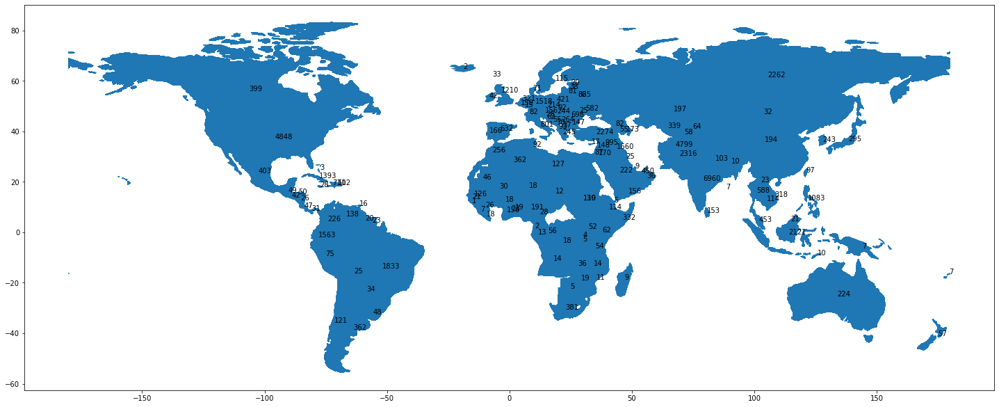

In [320]:
merge.plot(figsize=(25, 20))

for i in range(0, len(merge)):
    plt.text(float(merge.longitude[i]),float(merge.latitude[i]),"{}".format(merge.user_count[i]))
plt.show()

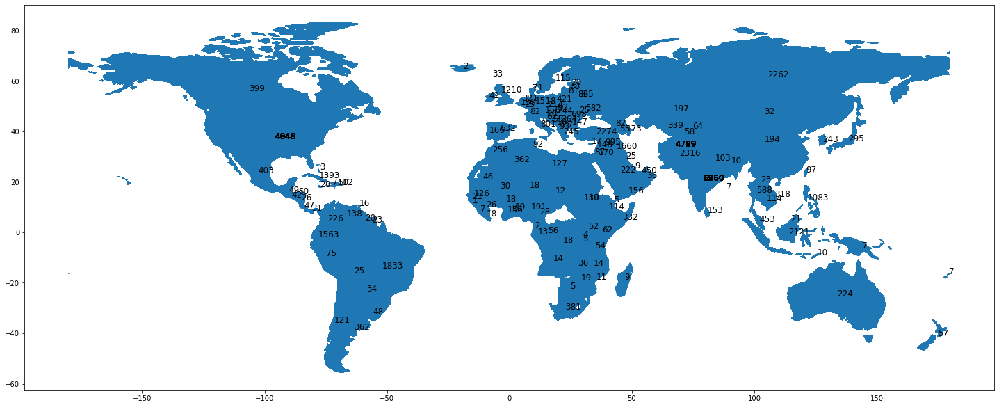

In [333]:
merge.plot(figsize=(25, 20))

for i in range(0, len(merge)):
    plt.text(float(merge.longitude[i]),float(merge.latitude[i]),"{}".format(merge.user_count[i]), fontsize='large')
plt.show()